# Análisis de operadores ineficaces para compañía de Telecomunicaciones

Debemos realizar un análisis de la eficacia de los operadores del servicio de telefonía virtual CallMeMaybe, quien está desarrollando una nueva función para que los supervisores(as) tengan información sobre los operadores menos eficaces. Los clientes de la compañía son organizaciones que necesitan distribuir una gran cantidad de llamadas entrantes entre varios operadores, o realizar llamadas salientes. Los operadores también pueden realizar llamadas internas para comunicarse entre ellos. Todas estas llamadas se efectúan a través de la red de CallMeMaybe.

Los parámetros para determinar la ineficiencia son:
- Una gran  cantidad de llamadas entrantes perdidas (internas y externas).
- Un tiempo de espera prolongado para llamadas entrantes.
- En el caso de realizarlas, un número reducido de llamadas salientes.

**Tabla de contenidos:**

 **1. Inicialización:**
 
    - Descripción de datos
    - Optimización de los datos

 **2. Análisis exploratorio:**
 
    - Información básica
    - Valores ausentes
    - Visualización de estadísticas
    - Registros por fecha
    - Variables críticas
    - Valores atípicos
    - Información de los clientes
    - Conclusiones del análisis exploratorio
 
 **3. Preprocesamiento:**
 
    - Registros duplicados
    - Valores ausentes
    - Corrección de tipo de datos
    - Valores atípicos
    - Unión de datasets
    - Conclusiones del preprocesamiento

 **4. Análisis y métricas de eficiencia**
     
    - Estudio y comprobación de datos
    - Estudio de variables de eficiencia
    - Construcción de métricas de eficiencia
    - Pruebas de hipótesis
    - Construcción de modelo de clasificación con ML
 
 **5. Conclusiones y recomendaciones**
 
 **6. Referencias y otros**

## Inicialización

In [1]:
# Cargamos las librerías necesarias
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import random
from scipy import stats as st

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import recall_score, precision_score, accuracy_score

Podemos contar con una alta carga de datos, por lo tanto, primero cargaremos una pequeña porción para verificar el tamaño y si es posible cargar los datos transformando algunas características desde un inicio.

### Primer dataset: información de la actividad y operadores

In [2]:
# Cargamos el primer dataset
telecom = pd.read_csv('telecom_dataset_us .csv')
# Vemos el tamaño de los datos
telecom.shape

(53902, 9)

Tenemos aproximadamente 54 mil registros y 9 columnas. Veamos la información y tamaño total para ver si es necesario optimizar el dataset:

In [3]:
# Vemos la información
telecom.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53902 entries, 0 to 53901
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   user_id              53902 non-null  int64  
 1   date                 53902 non-null  object 
 2   direction            53902 non-null  object 
 3   internal             53785 non-null  object 
 4   operator_id          45730 non-null  float64
 5   is_missed_call       53902 non-null  bool   
 6   calls_count          53902 non-null  int64  
 7   call_duration        53902 non-null  int64  
 8   total_call_duration  53902 non-null  int64  
dtypes: bool(1), float64(1), int64(4), object(3)
memory usage: 11.1 MB


**El peso de los datos es de 11.1MB, lo que puede resultar pesado considerando que incluiremos múltiples gráficos.**

Veamos la descripción que tenemos de los datos para ver las columnas que podemos optimizar.

#### Descripción de los datos

**Los datos se dividen en 9 columnas:**

**1. user_id:**

    - Descripción: ID de la cuenta del cliente.
    - Tipo de datos: int64.

**2. date:**

    - Descripción: fecha en la que se recuperaron las estadísticas.
    - Tipo de datos: Object.
    
**3. direction:**

    - Descripción: "dirección" de llamada ('out' para saliente, 'in' para entrante).
    - Tipo de datos: Object.
    
**4. internal:**

    - Descripción: si la llamada fue interna (entre los operadores de un cliente o clienta).
    - Tipo de datos: Object.
    
**5. operation_id:**

    - Descripción: identificador del operador.
    - Tipo de datos: float64.

**6. is_missed_call:**

    - Descripción: si fue una llamada perdida.
    - Tipo de datos: bool.

**7. calls_count:**

    - Descripción: Número de llamadas.
    - Tipo de datos: int64.
    
**8. call_duration:**

    - Descripción: duración de la llamada (sin incluír el tiempo de espera).
    - Tipo de datos: int64.

**9. total_call_duration:**

    - Descripción: duración de la llamada (incluído el tiempo de espera).
    - Tipo de datos: int64.

#### Optimización de los datos

Hay tres columnas que contienen datos posibles de optimizar:

- Date
        Es posible la carga en formato datetime desde un comienzo.

- Direction
        La cargamos como una columna 'category' de dos datos: in y out.

- Internal
        Se puede cargar como booleana (True y False) respondiendo a la pregunta ¿la llamada fue interna?


Comprobemos los valores y estructura de estas columnas:

In [4]:
# Vemos algunos valores de date
telecom['date'].head(5)

0    2019-08-04 00:00:00+03:00
1    2019-08-05 00:00:00+03:00
2    2019-08-05 00:00:00+03:00
3    2019-08-05 00:00:00+03:00
4    2019-08-05 00:00:00+03:00
Name: date, dtype: object

La fecha sin hora es la que debemos considerar, por lo tanto usarémos el método *parse_dates* al cargar el archivo.

In [5]:
# Vemos los valores de direction
telecom['direction'].value_counts()

out    31917
in     21985
Name: direction, dtype: int64

Con *direction* usarémos el método dtype al cargar los datos.

In [6]:
# Vemos los valores de internal
telecom['internal'].value_counts()

False    47621
True      6164
Name: internal, dtype: int64

Finalmente,**internal posee valores ausentes**, por lo tanto, cambiaremos más adelante sus datos.

In [7]:
# Reescribimos los datos y optimizamos el tamaño
telecom = pd.read_csv('telecom_dataset_us .csv',
                     dtype={'direction': 'category'},
                     parse_dates=['date'])

# Vemos la nueva información
telecom.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53902 entries, 0 to 53901
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype                                
---  ------               --------------  -----                                
 0   user_id              53902 non-null  int64                                
 1   date                 53902 non-null  datetime64[ns, pytz.FixedOffset(180)]
 2   direction            53902 non-null  category                             
 3   internal             53785 non-null  object                               
 4   operator_id          45730 non-null  float64                              
 5   is_missed_call       53902 non-null  bool                                 
 6   calls_count          53902 non-null  int64                                
 7   call_duration        53902 non-null  int64                                
 8   total_call_duration  53902 non-null  int64                                
dtypes: bool

**Disminuímos el tamaño de los datos de 11.1MB a 4.2MB.**

Veamos el otro dataset.

### Segundo dataset: información de los clientes

In [8]:
# Cargamos el segundo dataset
telecom_clients = pd.read_csv('telecom_clients_us.csv')
# Vemos el tamaño de los datos
telecom_clients.shape

(732, 3)

**Tenemos 732 registros en tres columnas.**

In [9]:
# Vemos la información
telecom_clients.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 732 entries, 0 to 731
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   user_id      732 non-null    int64 
 1   tariff_plan  732 non-null    object
 2   date_start   732 non-null    object
dtypes: int64(1), object(2)
memory usage: 95.2 KB


No existen valores ausentes en el dataset de clientes.

#### Descripción de los datos

**Los datos se dividen en 3 columnas:**

**1. user_id:**

    - Descripción: ID de la cuenta del cliente.
    - Tipo de datos: int64.

**2. tariff_plan:**

    - Descripción: tarifa actual de la clientela.
    - Tipo de datos: Object.
    
**3. date_start:**

    - Descripción: fecha de registro de la clientela.
    - Tipo de datos: Object.

#### Optimización de datos

Si bien el archivo no es pesado, las columnas de *tariff_plan* y *date_start* pueden ser iniciadas en otro formato. Veamos sus valores:

In [10]:
# Vemos los valores de los planes de tarifas
telecom_clients['tariff_plan'].value_counts()

C    395
B    261
A     76
Name: tariff_plan, dtype: int64

Tenemos valores A, B y C. Cargaremos esta columna como variable categorica.

In [11]:
# Vemos los valores de date_start
telecom_clients['date_start'].head()

0    2019-08-15
1    2019-08-23
2    2019-10-29
3    2019-09-01
4    2019-10-16
Name: date_start, dtype: object

Tenemos solo los valores de día/mes/año y no contamos con valores ausentes, por lo tanto podremos usar el método *parse_dates* al cargar el dataset.

In [12]:
# Reescribimos los datos y optimizamos el tamaño
telecom_clients = pd.read_csv('telecom_clients_us.csv',
                     dtype={'tariff_plan': 'category'},
                     parse_dates=['date_start'])

# Vemos la nueva información
telecom_clients.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 732 entries, 0 to 731
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   user_id      732 non-null    int64         
 1   tariff_plan  732 non-null    category      
 2   date_start   732 non-null    datetime64[ns]
dtypes: category(1), datetime64[ns](1), int64(1)
memory usage: 12.6 KB


**Ya tenemos nuestros dos dataset con los datos listos para un análisis exploratorio.**

## Análisis exploratorio de los datos

Comenzaremos por explorar superficialmente los datos para familiarizarnos con ellos. Con esto buscamos responder a algunas preguntas básicas para entender el origen, relaciones entre las características y necesidades de pre procesamiento.



- ***¿De dónde provienen los datos? ¿Cuál es el fin de trabajar con ellos y quienes son los clientes?****


     - Los dataset provienen de la compañía de telefonía virtual CallMeMaybe. 
     - Necesitamos identificar las características que conducen a tener operadores ineficaces.
     - Los clientes son organizaciones que necesitan distribuir una gran cantidad de llamadas entre los operadores.


- ***¿Cuál debe ser nuestro enfoque? y en base a esto, ¿cuáles son las características principales que debemos tener en cuenta?***


     - Debemos enfocarnos en medir la eficiencia de los operadores a través del tiempo. 
        
     - Las variables principales que debemos observar son: 
        
             1. Cantidad de llamadas perdidas 
             2. Tiempo promedio de espera para llamadas entrantes.
             3. Cantidad de llamadas salientes que realizan.


- ***¿Qué otras características se nos presentan? y ¿Cómo nos pueden ayudar a sacar conclusiones más precisas?***


     - Identificador de cada cliente.
                Tener información individualizada de cada cliente nos ayuda a saber quiénes tienen mayores molestias
                lo cual se representaría en mayor cantidad de llamados. Además podemos identificar la variación de las
                llamadas a lo largo de su ciclo de vida. 
                
                
     - Fecha del registro.
                La fecha es fundamental establecer comparaciones del comportamiento repecto a la eficacia de los 
                operadores.
                
                
     - Dirección de la llamada (entrante o saliente).
                Hacia dónde va el flujo nos permite tener una idea cómo y cuándo se producen periodos que pueden ser 
                críticos y que disminuyan la eficiencia.
                
                
     - Si la llamada es interna o no. 
                Las llamadas entre operadores nos permite ver la capacidad de resolución o si realmente hay una pérdida
                de eficiencia o malgasto de los recursos de la compañía.
                
                
     - Identificador del operador.
                Nos permite conectar todas las variables para generar características típicas de acuerdo a cada operador, 
                los meses que llevan trabajando, y el comportamiento de trabajo que van teniendo.
                
                
     - Si es una llamada perdida.
                Directamente relacionada con la eficiencia y resolución oportuna de los conflictos que van surgiendo.
                
                
     - Contador de llamadas por día.
                Nos permite cuantificar y establecer niveles de ineficacia u eficiencia.
                
                
     - Duración de las llamadas (sin tiempo de espera).
     - Duración de llamadas (con tiempo de espera).
                Estas variables, al igual que el contador, nos permiten cuantificar y establecer criterios apropiados para
                los niveles de eficiencia. 
                
                
     - Tarifa del plan.
                Podemos establecer patrones de comparación y generar algunas hipótesis. Si hay mayor capacidad resolutiva 
                por un plan que por sobre otro, si hay más o menos problemas para alguno, etc.
                
                
     - Fecha de inicio del cliente.
                Nos sirve para ver la evolución en la satisfacción del cliente a lo largo del tiempo.


- ***¿Existen valores ausentes? ¿Cómo los podemos tratar? y ¿qué impacto tendrían estos cambios?***

- ***¿Existen valores atípicos para alguna variable? ¿Qué deberíamos hacer con ellos?***

Estas últimas preguntas las resolveremos a continuación:

### Información básica de los datos

Recordamos la exploración inicial que hemos hecho a los dos dataset, precisamente el tamaño, tipos de dato y presencia de valores ausentes:

#### Tamaño de los dataset

In [13]:
# Primer datasetet: telecom
telecom.shape

(53902, 9)

In [14]:
#Segundo dataset: telecom_clients
telecom_clients.shape

(732, 3)

En el archivo que contiene el detalle específico de cada operador y las características principales a analizar, tenemos 53902 registros organizados en 9 columnas; mientras que en el segundo, existen 732 registros en 3 columnas.

#### Tipos de datos

Si bien, ya hemos corregido algunos tipos de datos en la carga inicial, todavía quedan algunos pendientes por problemas de valores ausentes. Las columnas que tenemos en cada dataset y su tipo son las siguientes:

**Primer dataset: telecom**

  *Columna / tipo*
- user_id / int64
- date / datetime64 (modificado al comienzo)
- direction / category (modificado al comienzo)
- internal / object (pendiente de cambio por valores ausentes)
- operator_id / float64
- is_missed_call / bool
- calls_count / int64
- call_duration / int64
- total_call_duration / int64


**Segundo dataset: telecom_clients**

  *Columna / tipo*
- user_id / int64
- tariff_plan / category (modificado al comienzo)
- date_start/ datetime64 (modificado al comienzo)


### Valores ausentes

Tenemos presencia de valores ausentes en dos columnas del primer dataset, específicamente en las columnas: **internal y operator_id**. Analizemos más sus valores para ver cómo vamos a tratar estos datos:

In [15]:
# Cantidad de valores ausentes en ambas columnas
print('Para la columna "internal" la cantidad de valores ausentes es:', telecom['internal'].isnull().sum())
print(' Su porcentaje respecto al total es:',((telecom['internal'].isnull().sum()*100) /len(telecom['internal'])).round(2),'%')
print('')
print('Para la columna "operator_id" la cantidad de valores ausentes es:', telecom['operator_id'].isnull().sum())
print(' Su porcentaje respecto al total es:',((telecom['operator_id'].isnull().sum()*100) /len(telecom['operator_id'])).round(2),'%')

Para la columna "internal" la cantidad de valores ausentes es: 117
 Su porcentaje respecto al total es: 0.22 %

Para la columna "operator_id" la cantidad de valores ausentes es: 8172
 Su porcentaje respecto al total es: 15.16 %


- **Internal describe si la llamada fue entre operadores o no.** Al ser booleana sus datos contienen valores True/False. Una solución rápida sería eliminar estos registros, pero al no estar entre las características más relevantes a observar, veremos la relación que se da con otras características para ver si se pueden rellenar estos valores por algún patrón que observemos u la media que se presente.

*Nota: recordamos que las características principales a observar son las siguientes:*
    
    1. Cantidad de llamadas perdidas 
    2. Tiempo promedio de espera para llamadas entrantes.
    3. Cantidad de llamadas salientes que realizan.
    
    
- **Operator_id**  corresponde a una variable fundamental ya que se involucra directamente a nuestro objetivo de identificar operadores ineficientes. Tenemos un 15.16% de operadores sin identificación, es un número importante que no podemos eliminar. **En este caso, y considerando el tipo de datos float64, le asignarémos un ID = 0 a todos estos operadores desconocidos.** Con esta medida, no alterarémos las conclusiones que podemos obtener de casi la quinta parte de los datos.


Ahora, continuemos lo pendiente. Analizamos la relación de internal con otros datos comparables mediante la distribución. Veremos la relación de las llamadas internas con: la fecha y la dirección de la llamada.

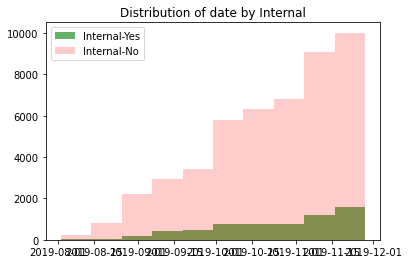

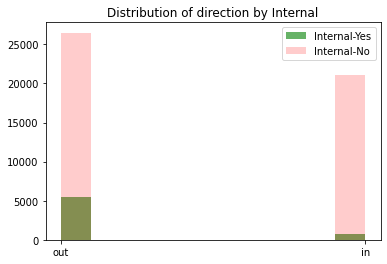

In [16]:
# Creamos una lista de las columnas a usar
internal_cols = ['date', 'direction']

# Creamos un ciclo for para generar cada gráfico
for col in internal_cols:
    plt.hist(telecom.query('internal == True')[col], alpha= 0.6, label='Internal-Yes', color='green')
    plt.hist(telecom.query('internal == False')[col], alpha= 0.2, label='Internal-No', color='red')
    plt.title(f'Distribution of {col} by Internal')
    plt.legend()
    plt.show()

De acuerdo a estas dos variables, la distribución no muestra diferencias relevantes considerando si es interna o no. **La proporción siempre es mayor para las llamadas externas.**

- Para la feccha de registro de llamada, tanto las llamadas internas como externas van en aumento, generando mayores saltos en las llamadas externas.
- En cuanto a la dirección, existen menos llamadas entrantes pero la proporción de internas o no es similar a las salientes.

Veamos según si es una llamada perdida:

<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.


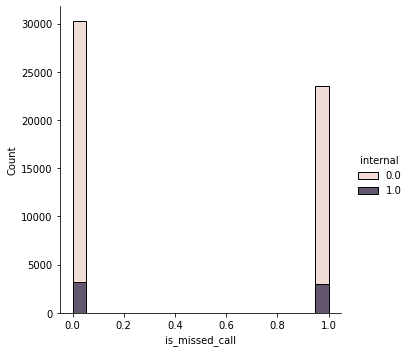

In [17]:
# Realizamos un gráfico de distribución utilizando la librería seaborn
sns.displot(data=telecom, x="is_missed_call", hue="internal", multiple="stack")

- La cantidad de llamadas externas es muy superior, existiendo menos de 5000 para las llamadas internas en cada caso (perdida y no).
- la proporción de llamadas internas aumenta para las que son llamadas perdidas debido a que hay menos.

De acuerdo a las observaciones realizadas, mantendrémos la proporción de valores de llamadas internas y no. No existen diferencias relevantes de acuerdo a las otras variables, por lo tanto, no se considerarán las otras características a la hora del reemplazo.

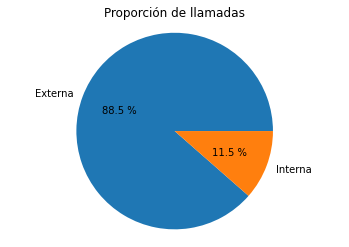

In [18]:
# Gráfico de proporción de llamadas
plt.pie(telecom['internal'].value_counts(), labels=['Externa','Interna'], autopct="%0.1f %%")
plt.title('Proporción de llamadas')
plt.axis("equal")
plt.show()

**En el preprocesamiento, se considerará esta proporción para reemplazar los valores ausentes en la columna internal.**

### Visualización de las estadísticas

#### Primer dataset: telecom

Utilizamos el método describe para ver las características de algunas columnas:

In [19]:
# Estadísticas
telecom.describe()

,user_id,operator_id,calls_count,call_duration,total_call_duration
count,53902.000000,45730.000000,53902.000000,53902.000000,53902.000000
mean,167295.344477,916535.993002,16.451245,866.684427,1157.133297
std,598.883775,21254.123136,62.917170,3731.791202,4403.468763
min,166377.000000,879896.000000,1.000000,0.000000,0.000000
25%,166782.000000,900788.000000,1.000000,0.000000,47.000000
50%,167162.000000,913938.000000,4.000000,38.000000,210.000000
75%,167819.000000,937708.000000,12.000000,572.000000,902.000000
max,168606.000000,973286.000000,4817.000000,144395.000000,166155.000000


- La media de llamadas por registro es de 16. Si consideramos la mediana, tenemos que **la mitad de registros posee menos de 4 llamadas** y un 75% del dataset corresponde a menos de 12 llamadas. **El nivel alto en la media se da por valores atípícos altos**, como por ejemplo, el máximo de 4817 llamadas. Tendremos que analizar los valores atípicos en esta columna.

- La media de tiempo de llamada es de 867 aproximadamente. **Todavía no tenemos certeza si se trata de segundos.** El **50% de los registros presentan valores bajo 38**, por lo tanto, **también existen valores atípicos altos**. La máxima de tiempo es de 144395.

- El tiempo total de llamadas considerando el tiempo de espera tiene una media de 1157. **La mitad de registros llega a tener una cifra de 210**. El máximo es de 166155, por lo tanto, **hay presencia de valores atípicos altos**.


Para concluir, será necesario revisar los altos valores atípicos en las columnas de cantidad y tiempos de llamada.

De acuerdo a los tiempos observados, y considerando que la mitad de los datos alcanza a la cifra de 38 (sin tiempo de espera) y 210 (con tiempo de espera) en tiempo de llamada; **podemos suponer que las cifras corresponden a segundos**. Las cifras en minutos serían demasiado altas considerando la naturaleza del servicio.

Veamos las estadísticas respectivas al tiempo:

In [20]:
# Estadísticas de date
telecom['date'].describe(datetime_is_numeric=True)

count                                  53902
mean     2019-10-23 01:00:32.191755520+03:00
min                2019-08-02 00:00:00+03:00
25%                2019-10-04 00:00:00+03:00
50%                2019-10-28 00:00:00+03:00
75%                2019-11-14 00:00:00+03:00
max                2019-11-28 00:00:00+03:00
Name: date, dtype: object

- La media cae para el día 23 de octubre de 2019.
- El primer registro corresponde al 2 de agosto de 2019 y el último al 28 de noviembre de 2019.

In [21]:
# Periodo de los datos
telecom['date'].max()-telecom['date'].min()

Timedelta('118 days 00:00:00')

**Los datos contemplan un periodo de 118 días, es decir, casi 4 meses.**

#### Segundo dataset: clientes de Telecom

Veamos las estadísticas de las fechas de ingreso de los clientes:

In [22]:
# Estadísticas de date
telecom_clients['date_start'].describe(datetime_is_numeric=True)

count                              732
mean     2019-09-14 16:39:20.655737600
min                2019-08-01 00:00:00
25%                2019-08-23 00:00:00
50%                2019-09-16 00:00:00
75%                2019-10-08 00:00:00
max                2019-10-31 00:00:00
Name: date_start, dtype: object

- La fecha promedio de registro se da el 14 de septiembre de 2019.
- La fecha de registro más antigua para un cliente es el 1 de agosto de 2019; mientras que el último es el 31 de octubre de 2019.

### Cantidad de registros por fecha 

Mediante un histograma, veamos la cantidad de registros que se tiene por fecha. 

Observaremos primero el dataset que contiene los datos generales, que abarca desde el *2 de agosto del 2019 al 28 de noviembre de 2019*.

In [23]:
# Histograma por fecha de registro
date_histogram_fig = px.histogram(telecom, x='date', title='Histograma de fechas de los registros',
                                      labels={'date':'Fecha del registro'},
                                      opacity=0.8,
                                      color_discrete_sequence=['indianred']
                                    )
date_histogram_fig.update_layout(height=500, width=800)
date_histogram_fig.show()

- Los registros van aumentando directamente llegando a alcanzar los 1200 a fines de noviembre. Si bien esto se podría considerar normal ya que se van sumando nuevos clientes, es necesario revisar en más detalle porque puede significar que no se esten resolviendo los problemas de estos.


- En agosto los registros estaban bajo la cifra de 200 diariamente; para septiembre ascendieron casi hasta 600; en octubre casi a los 1000; y finalmente, como lo mencionamos anteriormente, 1200 a fines de noviembre. Cada mes hubo un aumento de 400 registros, a diferencia del último donde fueron 200 registros de aumento.


- Se producen bajas en la cantidad de registros cada fin de semana y festivo. La cantidad registrada en estas fechas también va en ascenso pero llega a un máximo cercano a los 400 registros para fines de noviembre.

Veamos ahora un histograma de la fecha de ingresos de nuevos clientes:

In [24]:
# Histograma por fecha de ingreso de clientes
date_client_histogram_fig = px.histogram(telecom_clients, x='date_start', title='Histograma de fechas de ingresos de los clientes',
                                      labels={'date_start':'Fecha de inicio del cliente'},
                                      opacity=0.8,
                                      color_discrete_sequence=['cadetblue']
                                    )
date_client_histogram_fig.update_layout(height=500, width=800)
date_client_histogram_fig.show()

- La cantidad de clientes que va llegando no tiene grandes diferencias a través del tiempo. Se mantienen en torno a los 40 y 60 clientes de media.
- Las fechas con más registros son el 15 de septiembre, 25 de agosto y 6 de octubre. Estas tres fechas corresonden a un tramo intermedio del periodo de registros.
- Hacia el final se ve un declive en el ingreso de clientes llegando a 39 clientes registrados para el 2 de noviembre, cifra que logra de todas formas mantenerse superior al inicio (31 registros).

### Variables críticas

Observaremos las características que afectan directamente a nuestro objetivo (medir la eficiencia a través del tiempo).

#### Cantidad de llamadas perdidas

Agrupamos por fecha y sumamos la cantidad de llamadas perdidas o aceptadas.

In [25]:
# Agrupamos las llamadas por fecha y tipo de llamada
missed_call_grouped = telecom.groupby(['date','is_missed_call']).agg({'calls_count':'sum'})
# Reiniciamos el índice
missed_call_grouped = missed_call_grouped.reset_index()

In [26]:
# Cantidad de llamadas perdidas y aceptadas
fig_missed_call = px.line(missed_call_grouped, x='date', y='calls_count', color='is_missed_call', 
                          title='Diferencia entre llamadas perdidas/aceptadas en el tiempo',
                          labels={'is_missed_call':'¿Es llamada perdida?'})

fig_missed_call.update_layout(xaxis_title='Fecha', yaxis_title='Cantidad de llamadas')
fig_missed_call.show()

- A lo largo de todo el periodo, el comportamiento de la cantidad de llamados se presenta bastante similar.
- Durante septiembre hubo más llamadas contestadas que perdidas.
- Las primeras dos semanas de octubre se presentaron más críticas ya que las perdidas superaron a las contestadas y hubo uno de los picos más altos del registro para el 11 de octubre, con casi 11 mil llamadas perdidas (versus las 8600 contestadas).
- La segunda mitad de octubre bajaría la cantidad de llamadas perdidas volviendo a tener una relación similar a septiembre.
- La primera semana de noviembre se igualan las cantidades para luego tener un pico de llamadas perdidas para el 11 de noviembre, llegando a tener casi 11 mil llamadas.
- En la segunda mitad de noviembre se visualiza un descenso (como lo hemos visto en los otros meses) para finalmente comenzar a subir hacia fines de mes.


**Existen patrones claros. Los últimos meses se ha producido un pico de llamadas perdidas para el día 11 de cada mes (exceptuando septiembre)**. Este comportamiento se produce luego de que en la primera semana de cada mes se equilibran la cantidad de llamadas para luego generar este incremento en solo un día. Luego de esto, descienden considerablemente las llamadas perdidas hasta fin de mes donde otra vez se repite el ciclo.

Veamos más en detalle estas llamadas perdidas, observemos si en su mayoría se trata de llamadas entrantes o salientes:

**LLamadas perdidas: entrantes y salientes**

In [27]:
# Agrupamos las llamadas perdidas por fecha y dirección
missed_call_direction = telecom.query('is_missed_call == True').groupby(['date','direction']).agg({'calls_count':'sum'})
# Reiniciamos índice
missed_call_direction = missed_call_direction.reset_index()

In [28]:
# Cantidad de llamadas perdidas y su dirección
fig_direction_missed_call = px.line(missed_call_direction, x='date', y='calls_count', color='direction', 
                                    title="<b>Llamadas perdidas:</b> Diferencia entre salientes y entrantes",
                                    color_discrete_sequence=['green', 'magenta'])

fig_direction_missed_call.update_layout(legend_title_text='Dirección de la llamada', 
                                        xaxis_title='Fecha', 
                                        yaxis_title='Cantidad de llamadas')

fig_direction_missed_call.show()

- La mayoría de llamadas perdidas son las salientes, esto quiere decir, que no hay respuesta en gran parte de los intentos por establecer contacto por parte de los operadores.
- El incremento de llamadas desde septiembre a octubre pasa a ser el doble.
- En octubre se pueden apreciar los primeros picos hacia el 1 y 11 de este mes. En estos días se superaron las 6000 llamadas salientes en las que no hubo respuesta.
- El punto más alto se tiene el 11 de noviembre donde se llega a las casi 10 mil llamadas sin respuesta. Notamos que las llamadas perdidas entrantes en ese día no son las más altas de este tipo, llegando a la cifra de 1700 aproximadamente.
- Los puntos más criticos de llamadas perdidas en que los operadores no contestaron fue para el 7 y 11 de octubre, mientras que para noviembre fue el día 25.


El resultado de este gráfico nos dice que **la mayoría de llamadas perdidas son las que realizan los operadores y no hay respuestas**. El punto más crítico respecto a esto se encuentra el día 11 de noviembre, mientras que los puntos más altos para llamadas no contestadas son el 11 de octubre y 25 de noviembre.

Veamos la relación entre llamadas internas o externas para las llamadas perdidas.

**Llamadas perdidas: internas o externas**

In [29]:
# Agrupamos las llamadas perdidas por fecha y tipo
missed_call_internal = telecom.query('is_missed_call == True').groupby(['date','internal']).agg({'calls_count':'sum'})
# Reiniciamos índice
missed_call_internal = missed_call_internal.reset_index()

In [30]:
# Cantidad de llamadas perdidas y su dirección
fig_internal_missed_call = px.line(missed_call_internal, x='date', y='calls_count', color='internal', 
                                    title="<b>Llamadas perdidas:</b> Diferencia entre internas y externas",
                                    color_discrete_sequence=['goldenrod', 'indigo'])

fig_internal_missed_call.update_layout(legend_title_text='¿Es interna?', 
                                        xaxis_title='Fecha', 
                                        yaxis_title='Cantidad de llamadas')

fig_internal_missed_call.show()

- Por amplia superioridad las llamadas externas perdidas son más. 
- Dos de los días con mayor cantidad de llamadas perdidas internas fueron el 20 y 21 de noviembre, llegando a 213 llamadas. 
- Los días que más se perdieron llamadas perdidas externas fueron el 11 de octubre, 11 y 25 de noviembre.


Complementando la información recabada antes respecto a las llamadas perdidas, podemos darnos cuenta que **no hay mayor pérdida de comunicación entre los operadores**, solo hay periodos un poco más críticos como la semana del 20 de noviembre. Teniendo en cuenta los gráficos anteriores, **el grueso de las llamadas perdidas se encuentra en las que realizan los operadores a los clientes, lo que denota problemas de comunicación con estos mismos o fallas en las estrategias de comunicación sobre todo para el mes de octubre y noviembre.**

#### Tiempo promedio de espera para llamadas entrantes

Tenemos dos variables que nos ayudarán a calcular solo la espera: el total de tiempo de la llamada (con tiempo de espera) y el tiempo de la llamada sin espera. Creamos una nueva columna aplicando la diferencia de ambas columnas:

In [31]:
# Columna de tiempo de espera
telecom['wait_time'] = telecom['total_call_duration'] - telecom['call_duration']

La eficiencia de los operadores se puede ver reflejada en la prontitud con que respondan las llamadas. Esto va a estar directamente relacionado a la satisfacción del cliente. Veamos los tiempos de espera para las llamadas que llegan a los operadores. 

Las características del gráfico a continuación serán las siguientes:

    - Dirección: in (llamadas entrantes)
    - Tipo: externa (entre operador-cliente)
    - Llamadas perdidas: No

In [32]:
# Agrupamos por llamadas aceptadas, de tipo externa y entrantes
wait_time_incoming_calls = telecom.query('is_missed_call == False and internal == False and direction =="in"'
                                  ).groupby(['date']).agg({'wait_time':['max','mean']})
# Reiniciamos índice
wait_time_incoming_calls = wait_time_incoming_calls.reset_index()

# Cambiamos el nombre a las columnas
wait_time_incoming_calls.columns = ['date','max_time','mean_time']

In [33]:
# Tiempo de espera en llamadas entrantes

fig_wait_time_incoming_call = go.Figure()
                                
fig_wait_time_incoming_call.add_trace(go.Bar(
    x=wait_time_incoming_calls['date'],
    y=wait_time_incoming_calls['max_time'],
    name= 'Max waiting time per day',
    marker_color='indianred'))
 

fig_wait_time_incoming_call.add_trace(go.Scatter(
    x=wait_time_incoming_calls['date'],
    y=wait_time_incoming_calls['mean_time'],
    name= 'Mean time per day',
    marker_color='blue'))
    

fig_wait_time_incoming_call.update_layout(title='Tiempos máximos y medios de espera para las llamadas entrantes')
    
fig_wait_time_incoming_call.show()

- Existen algunos valores atípicos muy altos para los días 1, 2 y 3 de octubre; y en noviembre, el día 11.
- La media no sobrepasa los 200 segundos en todo el periodo. 
- Durante agosto y hasta la tercera semana de septiembre, los máximos no superaron los 500 segundos, lo que equivale a 8 minutos aproximadamente. Estas cifras son las más bajas ya que durante octubre y noviembre sobrepasan los 1000 segundos en su máxima.


En este gráfico queda claro que existen valores atípicos para todos los días; al menos 4 días sobrepasan los 3000 segundos lo que correspondería a 50 minutos de espera. Para ver algo más cercano a la realidad, graficaremos solo la media de tiempo:

In [34]:
# Media de tiempos de espera en llamadas entrantes
fig_mean_wait_time_incoming_call = px.bar(wait_time_incoming_calls, y='mean_time', x='date')
fig_mean_wait_time_incoming_call.update_layout(title='Tiempos medios de espera para las llamadas entrantes',
                                              height=500, width=800)
fig_mean_wait_time_incoming_call.show()

- Los tiempos medios de espera para septiembre están cercanos a 1 minuto. A partir de la última semana de septiembre comienzan a aumentar considerablemente.

- Los tiempos medios en octubre se mantienen altos y alcanzan su peak el 1, 12 y 13 de octubre. En general la media se mantiene en torno a los 100-140segundos.

- Durante noviembre las medias son un poco más bajas que octubre y se mantienen entre 100-120 segundos.


Hemos visto que existen muchos valores atípicos que distorsionan la medición. Por el momento sabemos que **existen diferencias importantes entre septiembre y los otros dos meses.**

#### Cantidad de llamadas salientes que realizan

Exploremos la cantidad de llamadas que realizan los operadores, primero analicemos las cantidades de acuerdo a si son entre operadores u clientes.

In [35]:
# Agrupamos las llamadas salientes por fecha y tipo
calls_out = telecom.query('direction =="out"').groupby(['date','internal']).agg({'calls_count':'sum'})
# Reiniciamos índice
calls_out = calls_out.reset_index()

In [36]:
# Cantidad de llamadas salientes de los operadores
fig_out_calls = go.Figure()

fig_out_calls.add_trace(go.Scatter(
    x=calls_out.query('internal == False')['date'],
    y=calls_out.query('internal == False')['calls_count'],
    name='Llamadas a clientes'))

fig_out_calls.add_trace(go.Scatter(
    x=calls_out.query('internal == True')['date'],
    y=calls_out.query('internal == True')['calls_count'],
    name='Llamadas a operadores'))


fig_out_calls.update_layout(title='<b>Llamadas salientes:</b> cantidad a clientes y operadores',
                                 legend_title_text='Tipo de llamada', xaxis_title='Fecha', yaxis_title='Cantidad de llamadas',
                               height=400, width=800)

fig_out_calls.show()

- Vemos que las llamadas a otros operadores se mantienen en cifras bajas y constantes. Solo se aprecian cambios más fuertes hacia noviembre.
- La cantidad de llamadas a clientes aumenta considerablemente hacia fines de septiembre y sobrepasa las 10 mil llamadas en octubre.
- El punto máximo se alcanza el 11 de noviembre donde se registran 15 mil llamadas a clientes.


Ya que hemos visto diferencias considerables entre los meses, veamos mediante un gráfico de cajas la distribución de los datos en cantidad de llamadas salientes hacia clientes para cada mes. Usaremos el dataset "telecom" para ver la distribución de todos los registros.

**Boxplot de llamadas salientes a clientes:**

Existen muchos valores atípicos que no nos permiten ver el comportamiento del grueso de datos. Si vemos los datos de los cuartiles, tenemos que ningún registro supera el límite de las 60 llamadas. Filtraremos estos datos solo considerando una cantidad de llamadas inferior a 100 por registro.

In [37]:
new_fig_boxplot_calls_to_clients = go.Figure()

#Agrupamos los datos de cada mes
new_fig_boxplot_calls_to_clients.add_trace(go.Box(
    y=telecom.query(
        'direction == "out" and internal == False and date <= "2019-08-31 00:00:00+03:00" and calls_count < 100')['calls_count'],
    name='Agosto', 
    marker_color = 'indianred'))

new_fig_boxplot_calls_to_clients.add_trace(go.Box(
    y=telecom.query(
        'direction == "out" and internal == False and "2019-08-31 00:00:00+03:00" < date <= "2019-09-30 00:00:00+03:00" and calls_count < 100')['calls_count'],
    name='Septiembre', 
    marker_color = 'lightseagreen'))

new_fig_boxplot_calls_to_clients.add_trace(go.Box(
    y=telecom.query(
        'direction == "out" and internal == False and "2019-09-30 00:00:00+03:00" < date <= "2019-10-31 00:00:00+03:00" and calls_count < 100')['calls_count'],
    name='Octubre', 
    marker_color = 'goldenrod'))

new_fig_boxplot_calls_to_clients.add_trace(go.Box(
    y=telecom.query(
        'direction == "out" and internal == False and "2019-10-31 00:00:00+03:00" < date <= "2019-11-30 00:00:00+03:00" and calls_count < 100')['calls_count'],
    name='Noviembre', 
    marker_color = 'indigo'))

new_fig_boxplot_calls_to_clients.update_layout(title='<b>Distribución:</b> cantidad de llamadas a clientes en cada mes',
                                               legend_title_text='Mes', yaxis_title='Cantidad de llamadas por registro',
                                               height=500, width=800)

new_fig_boxplot_calls_to_clients.show()

La distribución de la cantidad de llamadas salientes a clientes es similar entre los meses. Es de imaginar que de acuerdo al aumento en la cantidad de llamadas y tiempos de espera para los meses de octubre y septiembre, cada registro mostraría un mayor número de llamadas, pero por lo visto, lo que ha aumentado es la densidad de los datos y no los valores propios de estos (calls_count).


- La media de agosto es de 7 llamadas por registro. Teniendo el 50% de sus datos entre 2 y 16 llamadas por registro.
- La media de septiembre es de 6 llamadas por registro. Teniendo el 50% de sus datos entre 2 y 18 llamadas por registro.
- La media de octubre es de 7 llamadas por registro. Teniendo el 50% de sus datos entre 2 y 19 llamadas por registro.
- La media de noviembre es de 8 llamadas por registro. Teniendo el 50% de sus datos entre 2 y 21 llamadas por registro.

Como podemos ver, **las medias no cambian mucho y el márgen de aumento es leve (solo 1 llamada). Podemos suponer que el incremento de actividad se debe a la cantidad de registros en los últimos meses o los altos valores atípicos y no a la cantidad de llamadas por registro.**


### Valores atípicos a considerar

Ya hemos notado la presencia de valores atípicos en algunos datos. Recordamos que ya hemos visto algunos en los gráficos de:

- Distribución de los datos por fecha.
- Tiempos medios de espera para llamadas entrantes.
- Cantidad de llamadas a clientes cada mes.

Veremos mediante histogramas la distribución de los datos relativos a estas columnas y también la de otras que hayan quedado pendientes.

*Nota: la columna wait_time se creó a partir de call_duration y total_call_duration, por lo tanto, estas dos son las que tomaremos de base para visualizar la distribución.*


#### Distribución de las fechas

In [38]:
# Distribución de las fechas
distribution_date = px.histogram(telecom, 
                                 x=telecom['date'].unique(), 
                                 y=telecom.groupby('date').agg({'user_id':'count'})['user_id'], 
                                 title='Distribución de las fechas',
                                 labels={'x':'Fecha del registro', 'y':'cantidad de registros'},
                                 opacity=0.8,
                                 )
distribution_date.update_layout(height=400, width=700)
distribution_date.show()
#plt.show()
#sns.histplot

Teniendo como límite inferior el 2 de agosto y superior el 28 de noviembre, podemos dar cuenta de lo siguiente:
- No existen registros atípicos de acuerdo a las fechas. No se producen vacíos en días específicos y el aumento en la cantidad de datos sigue su curso natural de acuerdo al aumento de clientes.

*Nota: en el histograma de fechas se puede ver la cantidad específica para cada día y se puede confirmar la curva en ascenso que va teniendo la cantidad de datos.*

#### Distribución de la cantidad de llamadas

Con anterioridad vimos que en cantidad de llamadas hay cifras muy altas que nos podrían complicar una visualización adecuada. Veamos cuál es el número máximo:

In [39]:
# Máxima cantidad de llamadas por registro
telecom['calls_count'].max()

4817

Es una cifra bastante alta que se aleja mucho de lo normal. Acotaremos el gráfico a un máximo de 200 llamadas diarias para ver la distribución:

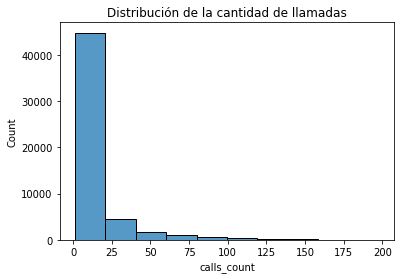

In [40]:
# Distribución de la cantidad de llamadas
sns.histplot(telecom.query('calls_count < 200')['calls_count'], bins=10)
plt.title('Distribución de la cantidad de llamadas')
plt.show()

- La gran mayoría de datos se encuentra hasta las 25 llamadas por registro.
- Cerca de unos 5000 registros presentan valores entre 25 y 50 llamadas.
- Va disminuyendo considerablemente hasta ya haber muy pocos sobre las 100 llamadas.

En base a estos datos, consideraremos como valores atípicos al 5% más extremo y consideraremos el eliminarlos del dataset. Calculemos los percentiles para ver desde qué cantidad se consideran valores extremos:

In [41]:
# Cálculo de percentiles
np.percentile(telecom['calls_count'], [90, 95, 99])

array([ 35.,  62., 166.])

- El 90% de los datos considera hasta 35 llamadas por registro.
- Menos del 5% tiene sobre 62 llamadas.
- Solo 1% tiene más de 166 llamadas.

Considerando que **el 95% de los datos está bajo 62 llamadas**, consideraremos eliminar estos registros de nuestros datos.

#### Distribución de la duración de las llamadas (sin tiempo de espera)

In [42]:
# Gráfico de dispersión de duración de llamadas
call_duration_distribution = px.scatter(telecom, 
                                        x='call_duration', 
                                        marginal_x='histogram', 
                                        labels={'call_duration':'Duración de la llamada', 'index':'Registro'},
                                        title='Dipersión de la duración de llamadas')
call_duration_distribution.show()

En este gráfico podemos identificar específicamente el número de registro (a través de su índice) que contiene una duración de llamada elevada. Algunas conclusiones que podemos sacar:

- Existe una gran cantidad de valores altos para algunos registros que están en torno al 6000 y 7000. Es probable que algo haya sucedido aquellos días que se vieron alterados significativamente los números.
- Más adelante se pueden apreciar nuevos valores atípicos en torno a los registros nros 30 mil, 40 mil y 50 mil; pero no en demasiada cantidad como la vista anteriormente.

El histograma en la parte superior demuestra que la línea de valores normales está bastante por debajo de lo que se puede apreciar en el gráfico, por lo tanto, acotaremos los valores a duraciones menores a 1000 para ver una distribución más realista:

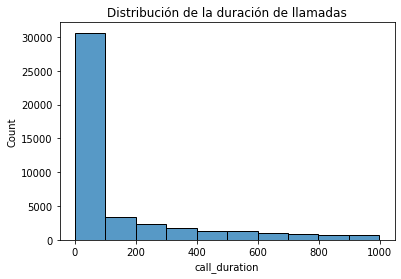

In [43]:
# Distribución de la duración de llamadas
sns.histplot(telecom.query('call_duration < 1000')['call_duration'], bins=10)
plt.title('Distribución de la duración de llamadas')
plt.show()

- Más de 30 mil datos mantienen sus valores bajo los 100 segundos de llamada.
- Cerca de 4000 datos se mantienen entre 100 a 200 segundos de llamada.

Se aprecia una disminución gradual y necesitaremos calcular los percentiles de datos para ver cuáles podríamos considerar más ajenos a la representación normal.

In [44]:
# Cálculo de percentiles
np.percentile(telecom['call_duration'], [90, 95, 97, 99])

array([ 2105.  ,  3739.95,  5372.97, 10333.9 ])

Los datos que vimos en el dato anterior (bajo 1000 segundos) pertenecen al 95% de los datos al menos. **Si queremos aislar y considerar atípico el 5% de datos superiores, tendríamos que considerar hasta los 3800 segundos aproximadamente; esto vendría correspondiendo casi a una hora de llamada, lo cual puede ser raro pero posible.**

#### Distribución de la duración de las llamadas (con tiempo de espera)

In [45]:
# Gráfico de dispersión de duración de llamadas con tiempo de espera
second_call_duration_distribution = px.scatter(telecom, 
                                        x='total_call_duration', 
                                        marginal_x='histogram', 
                                        labels={'total_call_duration':'Duración de la llamada', 'index':'Registro'},
                                        title='Dipersión de la duración de llamadas con tiempo de espera',
                                        color_discrete_sequence=['indianred'])

second_call_duration_distribution.show()

El gráfico es similar al anterior, por lo visto los tiempos de espera no han aumentado mucho el tiempo en otros registros ya que se mantiene el mismo patrón.

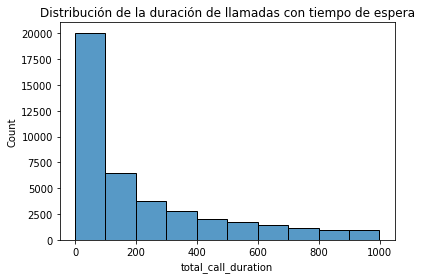

In [46]:
# Distribución de la duración de llamadas con tiempo de espera
sns.histplot(telecom.query('total_call_duration < 1000')['total_call_duration'], bins=10)
plt.title('Distribución de la duración de llamadas con tiempo de espera')
plt.show()

**Ahora se incrementa la cantidad de datos con tiempos mayores. Hubo un fuerte incremento en los registros entre 100 y 200 segundos. A pesar de esto, se mantiene el patrón conductual visto anteriormente.**

In [47]:
# Cálculo de percentiles
np.percentile(telecom['total_call_duration'], [90, 95, 97, 99])

array([ 2626.  ,  4540.  ,  6548.  , 12955.65])

Si consideramos el criterio anterior y solo dejamos el 95% de los datos más representativos, tendríamos que eliminar los registros que tengan una duración de más de 4540 segundos aproximadamente. **La suma de los tiempos de espera han hecho que el límite al 95% aumente en 800 segundos, es decir 13 minutos aproximadamente.**

### Información de los clientes

En el segundo dataset veremos la información de las tarifas y el porcentaje que representa cada plan; además, la distribución de fechas de ingreso de los clientes.



#### Participación de cada tarifa

In [48]:
# Asignamos una variable para los nombres (ordenados por cantidad)
tariff_names = ['Plan C', 'Plan B', 'Plan A']

# Asignamos los valores de acuerdo al método value_counts
tariff_values = telecom_clients['tariff_plan'].value_counts()

# Creamos el gráfico
tariff_fig = px.pie(telecom_clients, names=tariff_names, values=tariff_values, 
                    title='Tipos de tarifas para los clientes',
                    color_discrete_sequence= px.colors.qualitative.Pastel,
                    hole=.4)

tariff_fig.update_traces(textposition='inside', textinfo='percent')

tariff_fig.update_layout(annotations=[dict(text='3 tipos de plan', font_size=10, showarrow=False)],
                        height=400, width=500)
tariff_fig.show()

- Más de la mitad de los clientes pertenece al plan C.
- Una tercera parte de ellos al plan B.
- Solo un 10% pertenece al plan A.

#### Distribución de la llegada de clientes

Veamos un histograma de acuerdo a la fecha de ingreso de cada cliente:

In [49]:
# Histograma por fecha de ingreso
start_histogram_fig = px.histogram(telecom_clients, x='date_start', title='Histograma de fechas de ingreso de clientes',
                                      labels={'date_start':'Fecha del ingreso'},
                                      opacity=0.8,
                                      color_discrete_sequence=['darksalmon']
                                    )
start_histogram_fig.update_layout(height=400, width=600)
start_histogram_fig.show()

- La cantidad de ingresos no ha variado mucho de la media de 50 clientes aproximadamente por cada periodo. 
- Hay leves aumentos que no superan los 70 clientes y leves disminuciones que no bajan en egeneral de los 40 ingresos.

### Conclusiones del análisis exploratorio

**El primer dataset contiene la información general de los registros**: fecha, dirección de la llamada (entrante o saliente), interna o externa, llamada perdida o aceptada, contador de llamadas y duración de las mismas. Todas estas características están asociadas a un id de operador y un id de usuario (cliente).

- Existen 53902 registros en 9 columnas.

**El segundo nos presenta la información de los clientes:** identificación de usuario, tipo de rarifa y fecha de ingreso.

- Existen 732 registros en 3 columnas.


**Respecto a valores ausentes:**

- El primer dataset presenta valores ausentes en las columnas *internal* y *operator_id*.
- En *internal* existen 117 datos ausentes lo que corresponde a un 0.22% del total de datos.
- En *operator_id* existen 8172 datos ausentes lo que corresponde a un 15.16% de los datos.

Considerando que *operator_id* es una variable relacionada directamente al objetivo, le asignaremos el valor de "0" a todos los operadores desconocidos.

Para la variable *internal* se realizó un estudio del impacto que tiene la variable de acuerdo a otras características. Concluímos que la proporción se mantiene similar para todos los casos; el 88,5% corresponde a llamadas externas y 11,5% las llamadas internas. Si bien podríamos eliminar estos 117 datos por no ser significantes, los reemplazaremos manteniendo esta relación en los datos.

**Estadísticas de los datos:**

- Al menos la mitad de los registros posee menos menos de 4 llamadas por registro y un 75% del dataset contempla menos de 12 llamadas por registro. Existen altos valores atípicos para esta variable (calls_count).

- Al menos el 50% de las llamadas tienen una duración sin tiempo de espera de 38 segundos. Si consideramos con el tiempo de espera este valor llega a 210 segundos. Existe una presencia de bastantes valores atípicos según la desviación estándar.

- Con respecto a las fechas contempladas en los registros:

    - El primer registro corresponde al 2 de agosto del 2019 y el último el 28 de noviembre del 2019. Estos intervalos consideran un total de 118 días, casi 4 meses en total.
    
    - El primer registro de cliente se hizo un 1 de agosto de 2019 mientras que el último es el 31 de octubre del mismo año.

**Distribución de las fechas:**

- De acuerdo a las fechas, Cada mes hubo un aumento de 400 registros aproximadamente, menos para el último mes (noviembre) en el que subieron en 200. Es importante considerar que cada fin de semana hay una caída brusca en la cantidad de datos; esto quiere decir, que si queremos establecer patrones de comparación (como medias) no la podemos realizar diariamente.

- Las fechas de ingreso de clientes no muestran mayores anomalías, solo una pequeña baja hacia el final del periodo. Por lo general la media de cantidad de clientes se mantiene entre 40 y 60.


**Variables críticas:**

*Llamadas perdidas:*

- En general ha más llamadas aceptadas pero a través del tiempo el comportamiento de las curvas es bastante similar.

- A fines de septiembre y principios de octubre la cantidad de llamadas perdidas se incrementa superando a las aceptadas y llegando a los picos más alto del registro. Lo mismo vuelve a ocurrir a principios de noviembre.

- La cantidad de llamadas perdidas salientes son muchas más, esto quiere decir, llamadas que hacen operadores a clientes u otros operadores y que no son contestadas.

- Gran parte de las llamadas perdidas son externas. La cantidad de llamadas perdidas internas no logran superar las 213 llamadas, en cambio, las perdidas expertas llegan cerca de las 11 mil llamadas.

*Tiempos de espera:*

- Para las llamadas entrantes (llamadas a operadores) los tiempos de espera aumentan considerablemente para octubre y noviembre. Si en septiembre la espera era de 1 minuto, para los otros meses se duplicó.

*Cantidad de llamadas salientes:*

- La cantidad de llamadas salientes a clientes son ampliamente superiores a las entre operadores. Se producen peaks importantes para el 11 de octubre donde se llega a 13 mil llamadas a clientes y el 11 de noviembre donde se llega a 15 mil llamadas a clientes.

- La mediana en la cantidad de llamadas no difiere mucho y se mantiene entre 6 y 8 llamadas por registro. Al menos el 50% de los datos se mantiene bajo las 20 llamadas salientes por registro.


**Valores atípicos a considerar:**

- La cantidad de llamadas por registro presenta que la normalidad de sus datos está bajo las 62 llamadas, lo que corresponde al 95% de los datos. Consideramos necesario eliminar este 5% que presenta altos números.


- El tiempo de duración de llamada (sin tiempo de espera) lo limitaremos a 3800 segundos(aproximadamente una hora), lo cual corresponde al 95% de los datos. El 5% más alto no correspondería a la normalidad y distorsionaría bastante los resultados finales.


- El tiempo de duración de llamada (con tiempo de espera) para este mismo rango (95%) aumenta a 4540 segundos. Mantendremos esta relación en los datos al ser variables directamente relacionadas y eliminaremos el 5% restante (superior a los 4540 segundos). 


**Información de los clientes:**

- El 54% de los clientes pertenecen al plan C, 35,7% al plan B y 10,4% al plan A.
- Como mencionamos anteriormente, la fecha de llegada de los cliente no afecta en mayor cantidad a las llegadas por periodo. La media se mantiene en 50 clientes.



## Pre procesamiento

Gracias al análisis exploratorio de los datos, ya podemos hacernos una idea de las modificaciones que necesitan nuestros dataset antes de establecer métricas de ineficiencia para determinar el arquetipo de operadores ideales.


Algunas consideraciones y orden del pre procesamiento:

- Los nombres de las columnas son claros y no consideramos que necesiten cambios.
- Se comprobará si existen duplicados en los dos dataset.
- Se rellenarán los valores ausentes de internal y operator_id de acuerdo a lo establecido previamente.


- Algunos datos en que tenemos que corregir el tipo:

    - date: ajustar datetime solo a fecha sin hora.
    - internal: cambiar de object a int64 (tomando los valores True como 1 y False como 0)
    - operator_id: de float64 a int64.
    - is_missed_call: de bool a int64 (tomando los valores True como 1 y False como 0).
    

- Se eliminarán los valores atípicos de acuerdo a lo estipulado previamente. Las columnas afectadas serán las siguientes: 

    - Cantidad de llamadas (calls_count). 
    - Tiempo de duración de llamada (call_duration).
    - Tiempo total de duración (total_call_duration).


- Unión de los dataset mediante la columna *user_id*.

- Se ordenarán las columnas para una visualización más clara.

### Registros duplicados

Visualizamos la presencia de duplicados en los dos dataset:

In [50]:
# Duplicados para new_users
print('La cantidad de duplicados para telecom:', telecom.duplicated().sum())
print('')
# Duplicados para events
print('La cantidad de duplicados para telecom_clients es:', telecom_clients.duplicated().sum())
print('')

La cantidad de duplicados para telecom: 4900

La cantidad de duplicados para telecom_clients es: 0



**Tenemos 4900 registros duplicados en el registro general.** 

Procedemos a eliminarlos:

In [51]:
# Eliminamos los duplicados
telecom = telecom.drop_duplicates().reset_index(drop=True)

# Verificamos 
telecom.duplicated().sum()

0

Hemos eliminado correctamente los registros duplicados.

### Valores ausentes

#### Columna internal

De acuerdo al estudio inicial de datos concluímos que no existe algún patrón respecto a otra característica del registro. Los valores que toma esta columna tienen una relación de 88,5% de los datos para tipo externo (internal = False) y 11,5% para tipo interno (internal =True).

Teníamos 117 datos antes de eliminar los registros duplicados, veamos cuántos tenemos ahora y cuál es su nueva proporción:

Filtraremos los datos dejando solo los valores ausentes:

In [52]:
# Cantidad de ausentes en columna internal
print('La cantidad de valores ausentes es:', telecom['internal'].isnull().sum())

La cantidad de valores ausentes es: 110


In [53]:
telecom['internal'].value_counts()

False    43239
True      5653
Name: internal, dtype: int64

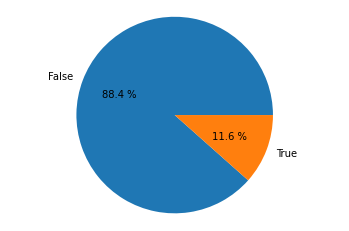

In [54]:
# Proporción de los datos
plt.pie(telecom['internal'].value_counts(), labels=['False','True'], autopct="%0.1f %%")
plt.axis("equal")
plt.show()

**Los valores ausentes disminuyeron a 110 y la porporción cambió a 88,4% para False y 11,6% para True.**

In [55]:
# Cantidad de datos que corresponde al 88.4%
(88.4*110) /100

97.24

**97 registros de los valores ausentes de internal se asignarán a False y 13 a True.**

In [56]:
# Vemos la tabla con los valores ausemtes
telecom.query('internal.isna()== True')

,user_id,date,direction,internal,operator_id,is_missed_call,calls_count,call_duration,total_call_duration,wait_time
917,166405,2019-09-18 00:00:00+03:00,in,NaN,NaN,True,1,0,59,59
996,166405,2019-10-01 00:00:00+03:00,in,NaN,NaN,True,1,0,1,1
1705,166406,2019-08-20 00:00:00+03:00,in,NaN,NaN,True,1,0,36,36
1761,166406,2019-09-02 00:00:00+03:00,in,NaN,879898.0,False,1,2,9,7
5645,166541,2019-09-26 00:00:00+03:00,in,NaN,908960.0,False,1,393,423,30
...,...,...,...,...,...,...,...,...,...,...
47702,168361,2019-11-09 00:00:00+03:00,in,NaN,NaN,True,6,0,14,14
47819,168361,2019-11-13 00:00:00+03:00,in,NaN,NaN,True,2,0,6,6
47844,168361,2019-11-14 00:00:00+03:00,in,NaN,NaN,True,1,0,2,2
48837,168579,2019-11-09 00:00:00+03:00,in,NaN,NaN,True,1,0,18,18


In [57]:
# Almacenamos los índices de estos valores
na_internal_index = telecom.query('internal.isna()== True').index

In [58]:
# Creamos una lista de índices a cambiar para True
true_val_index =[]
# De la lista de índices tomamos 97 valores al azar
for i in range(13):
    true_val_index.append(random.choice(na_internal_index))

In [59]:
#Creamos un ciclo for para rellenar los 13 valores ausentes de la lista por True
for i in true_val_index:
    telecom.loc[i,'internal'] = True

**Ya rellenamos los valores True al azar, ahora solo queda completar con los False.**

In [60]:
# Usamos el método fillna
telecom['internal'].fillna(False, inplace=True)

**Quedamos sin valores ausentes en la columna internal.**

#### Columna operator_id

Tenemos un 15% de operadores sin identificación. Generaremos un mismo id para todos estos. Comprobemos si actualmente no existe alguno que tenga asignado el id=0.

In [61]:
#Comprobamos valores de id
telecom.query('operator_id == 0')

,user_id,date,direction,internal,operator_id,is_missed_call,calls_count,call_duration,total_call_duration,wait_time


No existen operadores con el id=0 así que este se lo asignaremos al 15% desconocido.

In [62]:
# Usamos el método fillna
telecom['operator_id'].fillna(0, inplace=True)

**Ya hemos reemplazado todos los valores ausentes.**

### Corrección de tipo de datos

#### Columa date: fecha sin hora

In [63]:
# Veamos el formato actual de la fecha
telecom['date'].head()

0   2019-08-04 00:00:00+03:00
1   2019-08-05 00:00:00+03:00
2   2019-08-05 00:00:00+03:00
3   2019-08-05 00:00:00+03:00
4   2019-08-05 00:00:00+03:00
Name: date, dtype: datetime64[ns, pytz.FixedOffset(180)]

In [64]:
# Extraemos solo la fecha
telecom['date'] = pd.to_datetime(telecom['date']).dt.date

# Volvemos a pasarlo a datetime (pero ahora sin tiempo) para poder usar filtros a futuro
telecom['date'] = pd.to_datetime(telecom['date'], format= '%Y-%m-%d')

# Vemos como queda la fecha
telecom['date'].head()

0   2019-08-04
1   2019-08-05
2   2019-08-05
3   2019-08-05
4   2019-08-05
Name: date, dtype: datetime64[ns]

#### Columna internal: object a int64

In [65]:
# Usamos el método astype. Los valores True tomarán el valor de 1 y False de 0.
telecom['internal'] = telecom['internal'].astype('int')

#### Columna operator id: float64 a int64

In [66]:
# Cambiamos el tipo con el método astype
telecom['operator_id'] = telecom['operator_id'].astype('int')

#### Columna is_missed_call: booleano a int64

In [67]:
# Usamos el método astype. Los valores True tomarán el valor de 1 y False de 0.
telecom['is_missed_call'] = telecom['is_missed_call'].astype('int')

### Corrección de valores atípicos

Tenemos tres columnas en las que realizaremos cambios:

    1. Cantidad de llamadas (calls_count). 
    2. Tiempo de duración de llamada (call_duration).
    3. Tiempo total de duración (total_call_duration).

*Nota: A partir de este punto, crearemos un nuevo dataset actualizado con los registros sin valores atípicos.*

#### Cantidad de llamadas

Consideramos quue lo normal de los comportamiento de los operadores se encuentra bajo las 62 llamadas por registro, que es equivalente al 95% de los datos. Sobre esta cantidad de llamadas se elevan demasiado los valores.

Filtraremos el dataset considerando menos de 62 llamadas en esta columna:

In [68]:
# Creamos un dataset actualizado
telecom_upd = telecom.query('calls_count <62')

# Vemos el nuevo tamaño del registro
telecom_upd.shape

(46519, 10)

**Hemos eliminado el 5% de los datos con valores atípicos altos en calls_count y ahora tenemos 46519 registros.**

#### Tiempo de duración de llamadas (sin tiempo de espera)

Consideramos que el comportamiento normal se limita hasta los 3800 segundos (1 hora) lo que corresponde al 95% de los datos.

Filtramos los valores bajo esta cantidad de tiempo:

In [69]:
# Actualizamos el dataset
telecom_upd = telecom_upd.query('call_duration < 3800')

# Vemos el nuevo tamaño del registro
telecom_upd.shape

(45286, 10)

**Hemos disminuíudo de 46519 a 45286 registros respecto de la actualización anterior.**

#### Tiempo de duración de llamadas (con tiempo de espera)

Para mantener el mismo criterio de filtro de tiempo, quitarémos los valores que sobrepasan el 95% de la normalidad de datos. El tiempo de corte será 4540 segundos. Todo valor mayor o igual a este será eliminado.

In [70]:
# Actualizamos el dataset
telecom_upd = telecom_upd.query('total_call_duration < 4540')

# Vemos el nuevo tamaño del registro
telecom_upd.shape

(45260, 10)

**Solo hemos disminuído en 26 registros a diferencia de la actualización anterior. Por lo tanto podemos suponer que gran parte de los altos valores atípicos estaba concentrado en las llamadas sin tiempo de espera, y solo 26 registros de tiempos de espera prolongaban demasiado las llamadas.**

### Unión de datasets: telecom_upd y telecom_clients

Unirémos la información de los clientes mediante el identificador (user_id). Con esta unión buscamos generar análisis en base a la relación de clientes con operadores y si se produce alguna diferencia por el tipo de plan.

In [71]:
# Unimos los datasets con el método merge
telecom_upd = telecom_upd.merge(telecom_clients, on='user_id', how='left')

#Vemos como queda la tabla
telecom_upd.head(10)

,user_id,date,direction,internal,operator_id,is_missed_call,calls_count,call_duration,total_call_duration,wait_time,tariff_plan,date_start
0,166377,2019-08-04,in,0,0,1,2,0,4,4,B,2019-08-01
1,166377,2019-08-05,out,1,880022,1,3,0,5,5,B,2019-08-01
2,166377,2019-08-05,out,1,880020,1,1,0,1,1,B,2019-08-01
3,166377,2019-08-05,out,1,880020,0,1,10,18,8,B,2019-08-01
4,166377,2019-08-05,out,0,880022,1,3,0,25,25,B,2019-08-01
5,166377,2019-08-05,out,0,880020,0,2,3,29,26,B,2019-08-01
6,166377,2019-08-05,out,0,880020,1,8,0,50,50,B,2019-08-01
7,166377,2019-08-05,in,0,0,1,6,0,35,35,B,2019-08-01
8,166377,2019-08-06,in,0,0,1,4,0,62,62,B,2019-08-01
9,166377,2019-08-06,out,0,881278,1,3,0,29,29,B,2019-08-01


**Producto de la únión se han añadido las dos columnas del dataset de clientes; por lo tanto, ahora cada registro va a contar con la información del cliente al cual está asociado.**

### Orden de columnas

Ordenamos las columnas del dataset para una mejor visualización:

In [72]:
# Ordenamos las columnas con reindex
telecom_upd = telecom_upd.reindex(columns=['user_id','tariff_plan','date_start',
                                           'date','operator_id','internal','direction','is_missed_call',
                                           'calls_count','call_duration','total_call_duration','wait_time'])

#Vemos como queda la tabla
telecom_upd.head()

,user_id,tariff_plan,date_start,date,operator_id,internal,direction,is_missed_call,calls_count,call_duration,total_call_duration,wait_time
0,166377,B,2019-08-01,2019-08-04,0,0,in,1,2,0,4,4
1,166377,B,2019-08-01,2019-08-05,880022,1,out,1,3,0,5,5
2,166377,B,2019-08-01,2019-08-05,880020,1,out,1,1,0,1,1
3,166377,B,2019-08-01,2019-08-05,880020,1,out,0,1,10,18,8
4,166377,B,2019-08-01,2019-08-05,880022,0,out,1,3,0,25,25


### Conclusiones del preprocesamiento

Creamos un nuevo dataset resultado de la unión de los dos que disponíamos: telecom y telecom_clients. Este dataset final contiene toda la información importante para el análisis y se han tratado valores ausentes, atípicos y algunas correcciones menores para el tratamiento de datos.

En resumen, los cambios hechos son los siguientes:
- Se han eliminado 4900 registros duplicados en el dataset telecom.
- Posterior a la eliminación de duplicados, la cantidad de valores ausentes en internal disminuyó a 110, los cuales fueron reemplazados utilizando el método random. Se asignaron 97 registros al azar como False y los 13 restantes como True.
- En la columna operator_id se asignó el valor de 0 a todos los operadores desconocidos (ausentes).
- Se cambió el tipo de datos de la fecha para eliminar la hora asociada.
- Las columnas de valores boleeanos, internal y is_missed_call, se cambiaron a enteros.
- operator_id se cambió de tipo flotante a entero.

- Respecto a los valores atípicos, se usó el criterio de mantener el 95% de los datos que reflejan el comportamiento más común para los operadores. El 5% extremo fue eliminado tanto para la cantidad de llamadas y tiempos de llamada.

- Finalmente, se unieron los dataset en uno nuevo llamado telecom_upd y se ordenaron las columnas. Este **nuevo dataset presenta 45260 registros y 12 columnas.**


## Análisis y métricas de eficiencia

Para desarrollar un análisis ordenado que atienda todos los puntos que requiere esta investigación del **comportamiento de los operadores**, estableceremos una base inicial de preguntas para ir respondiendo durante el desarrollo y que sea de guía en nuestra investigación.

**Antes de comenzar nuestro análisis, debemos recordar el eje por el cual queremos guiar el proceso:**

*Nuestro objetivo: Medir la eficiencia de los operadores*

Para esto, será fundamental observar estos niveles de eficiencia **a través del tiempo** para generar comparaciones adecuadas.


Algunos parámetros que nos indican previamente para medir la eficiencia son:

- Una gran  cantidad de llamadas entrantes perdidas (internas y externas).
- Un tiempo de espera prolongado para llamadas entrantes.
- En el caso de realizarlas, un número reducido de llamadas salientes.

En el desarrollo indagarémos sobre estas características, sus condiciones; y buscaremos establecer nuevas relaciones.

### Planteamiento de interrogantes

Hay cinco aspectos importantes que debemos atender con los datos que tenemos:

    1. Estudio y comprobación de los datos.
    2. Estudio de variables de eficiencia.
    3. Construcción de métricas de eficiencia.
    4. Pruebas de hipótesis respecto a grupos de operadores.
    5. Construcción de modelo de clasificación con ML.


Considerando los datos que disponemos y los segmentos de análisis mencionados anteriormente, algunas preguntas que nos podemos hacer son:

*Estudio y comprobación de los datos:*

    - ¿Cúantos registros existen y cómo aumentan con el tiempo?
    - ¿Cuántos operadores hay?¿Todos emiten llamadas?
    - ¿Cuál es el promedio de registros por operador?
    - ¿Cuáles son las estadísticas para cada operador?
    - ¿Existe algún comportamiento que se distinga a través del tiempo?
    - Respecto a los clientes, ¿Qué características presentan? 
    

*Estudio de variables de eficiencia:*

    - ¿Cómo se relacionan las variables entre si?
    - ¿Qué relación se da entre las llamadas perdidas con las otras variables?
    - ¿Qué características provocan que aumente el tiempo de espera?
    - ¿Qué relación se da entre la cantidad de llamadas y el nivel de eficiencia?
    
    
*Construcción de métricas de eficiencia:*

    - De acuerdo a lo visto en el análisis de las variables, ¿Qué podemos definir como eficiente?
    - En base a la relación entre variables ¿Qué métricas específicas sería relevante incluír? 
    
    
*Pruebas de hipótesis respecto a grupos de operadores:*

    - ¿Cuántos operadores catalogamos como eficientes/ineficientes?
    - ¿Cuál es la proporción entre los grupos?
    - ¿Podemos confirmar que los grupos se dividieron correctamente?
    - ¿Qué nivel de significación podemos establecer para probar las hipótesis?
 
 
*Construcción de modelo de clasificación con ML*
 
    - ¿Qué características presentan los grupos de operadores?
    - Respecto a los niveles de eficiencia ¿Cómo los podríamos catalogar?
 

### Estudio y comprobación de datos

#### Cantidad de registros en el tiempo

In [73]:
# Periodo abarcado
print('Los registros van desde el:', telecom['date'].min(), 'hasta el', telecom['date'].max())

Los registros van desde el: 2019-08-02 00:00:00 hasta el 2019-11-28 00:00:00


In [74]:
# Histograma por fecha de registro
date_hist_upd = px.histogram(telecom_upd, x='date', title='Histograma de fechas de los registros',
                                      labels={'date':'Fecha del registro'},
                                      opacity=0.8,
                                      color_discrete_sequence=['indianred']
                                    )
date_hist_upd.update_layout(height=500, width=800)
date_hist_upd.show()

- La curva en ascenso es constante y llega a una máxima cercana a los 1000 registros por día.
- Cada semana está claramente diferenciada por una baja en la cantidad de registros hacia el fin de semana.
- En septiembre los registros se mantuvieron entre 200 y 400 por día aproximadamente; en octubre entre 400 y 800 aproximadamente; en noviembre entre 800 y 1000. De acuerdo a esto podemos interpretar que **el salto en octubre fue más grande.**

#### Cantidad de operadores

In [75]:
# Operadores únicos
telecom_upd['operator_id'].nunique()

1093

**Tenemos 1093 operadores únicos.** Veamos si todos emiten llamadas.

In [76]:
# Cantidad de usuarios únicos que emiten llamadas
telecom_upd.query('direction =="out"')['operator_id'].nunique()

883

De 1093 operadores, **883 realizan llamadas**. Esto corresponde a un 81% aproximadamente.

Veamos la cantidad de operadores que reciben llamadas:

In [77]:
# Cantidad de usuarios únicos que reciben llamadas
telecom_upd.query('direction =="in"')['operator_id'].nunique()

755

De 1093 operadores, **755 reciben llamadas**. Esto corresponde a un 69% aproximadamente.

En base a los resultados, existen usuarios mixtos, es decir, que realizan ambas funciones; mientras que otros al parecer solo realizan una función. Veamos el detalle de esto:

In [78]:
# Agrupamos los datos por operador y contamos si sigue 1 o las 2 direcciones
operator_direction = telecom_upd.groupby(['operator_id']).agg({'direction':'nunique'})

# Reiniciamos índice
operator_direction = operator_direction.reset_index()

# Contamos los operadores de 1 y 2 direcciones
operator_direction_count = operator_direction.groupby('direction').agg({'operator_id':'count'})


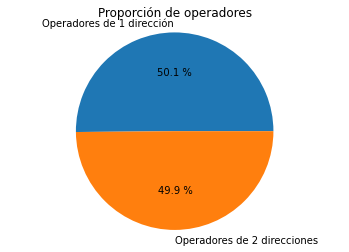

In [79]:
# Proporción de los datos
plt.pie(operator_direction_count['operator_id'], 
        labels=['Operadores de 1 dirección','Operadores de 2 direcciones'], 
        autopct="%0.1f %%")
plt.title('Proporción de operadores')
plt.axis("equal")
plt.show()


**La cantidad es muy similar para los que se dedican a una sola dirección y los que hacen ambas labores.** 548 operadores solo trabajan en una dirección y 545 en ambas.

Veamos el detalle de los que se dedican solo a una dirección:

Tomamos nuestra variable *operator_direction*, filtramos solo por los que siguen una dirección y creamos una lista de los id de operadores:

In [80]:
# Creamos una lista con los operadores de una dirección
one_dir_operators = operator_direction.query('direction == 1')['operator_id'].tolist()

# Cantidad de operadores de una dirección
len(one_dir_operators)

548

**Los operadores de una dirección son 548.**

In [81]:
# Filtramos por los operadores de una sola dirección y contamos los valores de la columna direction
one_dir_operators_count = telecom_upd.query(
                            'operator_id in @one_dir_operators').groupby(
                            ['operator_id','direction']).agg({'internal':'count'})

one_dir_operators_count = one_dir_operators_count.reset_index()

#Lista de los operadores de una dirección, su dirección y cantidad de registros
one_dir_operators_count = one_dir_operators_count.query('internal > 0')

one_dir_operators_count

,operator_id,direction,internal
1,880240,out,12
3,881278,out,8
4,882476,in,3
6,882680,in,43
9,883018,out,1
...,...,...,...
1086,971354,in,2
1089,972408,out,2
1091,972410,out,4
1093,973120,out,2


In [82]:
# Contamos los valores de dirección
one_dir_operators_count['direction'].value_counts()

out    338
in     210
Name: direction, dtype: int64

**De los operadores que solo trabajan en una dirección, 338 están destinados a generar llamadas y 210 solo a recibir.**

Actualizamos nuestro gráfico circular:

In [83]:
# Asignamos una variable para los nombres (ordenados por cantidad)
direction_operators_names = ['Operadores de 2 direcciones', 'Operadores de llamadas salientes', 
                             'Operadores de llamadas entrantes']

# Asignamos los valores de acuerdo al método value_counts
direction_operators_values = [545,338,210]

# Creamos el gráfico
direction_operators_fig = px.pie(telecom_upd, names=direction_operators_names, values=direction_operators_values, 
                    title='Tipo de operador según la dirección de la llamada',
                    color_discrete_sequence= px.colors.qualitative.Pastel,
                    hole=.4)

direction_operators_fig.update_traces(textposition='inside', textinfo='percent')

direction_operators_fig.update_layout(annotations=[dict(text='3 tipos de operador', font_size=10, showarrow=False)],
                                     height=500, width=600)
direction_operators_fig.show()

- Casi la mitad de los operadores emiten y reciben llamadas.
- un 30% de los operadores solo emiten llamadas y cerca de un 20% solo reciben llamadas.

**Veamos el detalle según las llamadas internas o externas.** *¿Habrá operadores destinados solo a comunicarse entre ellos y otros solo con los clientes?*

**Cantidad de operadores según internal:**

In [84]:
# Cantidad de usuarios únicos que hacen llamadas internas
telecom_upd.query('internal == 1')['operator_id'].nunique()

571

De 1093 operadores, **572 emiten o reciben llamadas internas, es decir, entre operadores**. Esto corresponde a un 52% aproximadamente.

Veamos la cantidad de operadores que emiten o reciben llamadas externas:

In [85]:
# Cantidad de usuarios únicos que reciben llamadas
telecom_upd.query('internal == 0')['operator_id'].nunique()

1056

De 1093 operadores, **1056 emiten o reciben llamadas de clientes**. Esto corresponde a un 97% aproximadamente.

En base a los resultados, existen usuarios mixtos que cumplen ambas funciones, comunicarse entre operadores y clientes. 

Veamos en detalle la distribución del tipo de operador:

In [86]:
# Agrupamos los datos por operador y contamos si cumple 1 o 2 funciones
operator_inter_external = telecom_upd.groupby(['operator_id']).agg({'internal':'nunique'})

# Reiniciamos índice
operator_inter_external = operator_inter_external.reset_index()

# Contamos los operadores de 1 y 2 direcciones
operator_inter_external_count = operator_inter_external.groupby('internal').agg({'operator_id':'count'})

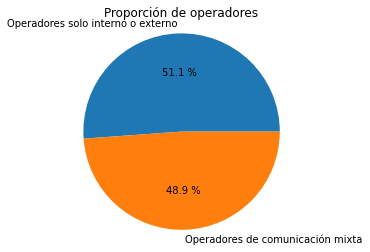

In [87]:
# Proporción de los datos
plt.pie(operator_inter_external_count['operator_id'], 
        labels=['Operadores solo interno o externo','Operadores de comunicación mixta'], 
        autopct="%0.1f %%")
plt.title('Proporción de operadores')
plt.axis("equal")
plt.show()


**La cantidad es muy similar para ambos timpos de operadores.** 558 operadores solo trabajan en llamadas internas o externas y 535 en ambas.

Veamos el detalle de los que se dedican solo a un tipo:

Tomamos nuestra variable *operator_inter_external*, filtramos solo por los que siguen un tipo y creamos una lista de los id de operadores:

In [88]:
# Creamos una lista con los operadores de una dirección
one_inter_ext_operators = operator_inter_external.query('internal == 1')['operator_id'].tolist()

# Cantidad de operadores de una dirección
len(one_inter_ext_operators)

559

**Los operadores de una dirección son 558.**

In [89]:
# Filtramos por los operadores de un solo tipo y contamos los valores de la columna internal
one_inter_ext_operators_count = telecom_upd.query(
                                'operator_id in @one_inter_ext_operators').groupby(
                                ['operator_id','internal']).agg({'direction':'count'})

one_inter_ext_operators_count = one_inter_ext_operators_count.reset_index()

#Lista de los operadores de un tipo, interno o externo y cantidad de registros
one_inter_ext_operators_count = one_inter_ext_operators_count.query('direction > 0')

one_inter_ext_operators_count

,operator_id,internal,direction
0,882476,0,3
1,882688,0,9
2,883018,0,1
3,883898,0,1
4,883940,0,36
...,...,...,...
554,972408,0,2
555,972410,0,4
556,972412,0,5
557,973120,0,2


In [90]:
# Contamos los valores por tipo
one_inter_ext_operators_count['internal'].value_counts()

0    522
1     37
Name: internal, dtype: int64

**De los operadores de un tipo, 521 solo reciben o emiten llamadas a clientes y 37 solo entre operadores.**

Actualizamos nuestro gráfico circular:

In [91]:
# Asignamos una variable para los nombres (ordenados por cantidad)
internal_operators_names = ['Operadores mixtos', 'Operadores exclusivos de clientes', 
                             'Operadores exclusivos para operadores']

# Asignamos los valores de acuerdo al método value_counts
internal_operators_values = [535,521,37]

# Creamos el gráfico
internal_operators_fig = px.pie(telecom_upd, names=internal_operators_names, values=internal_operators_values, 
                    title='Tipo de operador según el tipo de la llamada (interna/externa)',
                    color_discrete_sequence= px.colors.qualitative.Safe,
                    hole=.4)

internal_operators_fig.update_traces(textposition='inside', textinfo='percent')

internal_operators_fig.update_layout(annotations=[dict(text='3 tipos de operador', font_size=12, showarrow=False)],
                                    height=500, width=700)
internal_operators_fig.show()

- El número de operadores que se dedican exclusivamente a los clientes es casi el mismo que los operadores que se comunican con operadores y clientes.
- El número de operadores que solo se comunica entre operadores es de 37 y representa solo un 3% del total.

**Ya tenemos la proporción según cada variable, pero ¿cuál sería el porcentaje de cada uno si combinamos las características?**

#### Cantidad de operadores: identificación de tipo de operador

Agruparemos los operadores según las dos características que trabajamos antes: internal y direction.

In [92]:
# Agrupamos los operadores
operators_grouped_final = telecom_upd.groupby(['operator_id','internal','direction']).agg({'calls_count':'count'})

# Reiniciamos índice
operators_grouped_final = operators_grouped_final.reset_index()

# Filtramos las combinaciones que tienen actividad
operators_grouped_final = operators_grouped_final.query('calls_count >0')

# Vemos la tabla
operators_grouped_final

,operator_id,internal,direction,calls_count
0,0,0,in,6743
1,0,0,out,133
2,0,1,in,292
3,0,1,out,38
4,879896,0,in,21
...,...,...,...,...
4360,972460,0,in,1
4361,972460,0,out,4
4363,972460,1,out,2
4365,973120,0,out,2


In [93]:
# Creamos listas vacías para grupos de combinaciones
op_external_n_in = []
op_external_n_out = []
op_internal_n_in = []
op_internal_n_out = []

In [94]:
# De acuerdo a la tabla, vamos a definir las funciones de tipos de operadores:
for i in operators_grouped_final.index:
    
    if operators_grouped_final.loc[i,'internal'] == 0 and operators_grouped_final.loc[i,'direction'] == 'in':
        op_external_n_in.append(operators_grouped_final.loc[i,'operator_id'])
    
    if operators_grouped_final.loc[i,'internal'] == 0 and operators_grouped_final.loc[i,'direction'] == 'out':
        op_external_n_out.append(operators_grouped_final.loc[i,'operator_id'])

    if operators_grouped_final.loc[i,'internal'] == 1 and operators_grouped_final.loc[i,'direction'] == 'in':
        op_internal_n_in.append(operators_grouped_final.loc[i,'operator_id'])

    if operators_grouped_final.loc[i,'internal'] == 1 and operators_grouped_final.loc[i,'direction'] == 'out':
        op_internal_n_out.append(operators_grouped_final.loc[i,'operator_id'])

Crearemos un dataframe con la lista de usuarios únicos y en sus columnas tendrá el tipo de combinación:

In [95]:
# Creamos el dataframe y sus columnas
operators_table = pd.DataFrame(columns=['operator','external_in','external_out','internal_in','internal_out'])

# Agregamos los operadores únicos
operators_table['operator'] = telecom_upd['operator_id'].unique()

In [96]:
# Creamos ciclo for para asignar un "Yes" a la característica que corresponda
for i in operators_table.index:
    
    if operators_table.loc[i,'operator'] in op_external_n_in:
        operators_table.loc[i,'external_in'] = "Yes"
        
    if operators_table.loc[i,'operator'] in op_external_n_out:
        operators_table.loc[i,'external_out'] = "Yes"
    
    if operators_table.loc[i,'operator'] in op_internal_n_in:
        operators_table.loc[i,'internal_in'] = "Yes"
    
    if operators_table.loc[i,'operator'] in op_internal_n_out:
        operators_table.loc[i,'internal_out'] = "Yes"

In [97]:
# Llenamos los valores ausentes con "No"
operators_table = operators_table.fillna('No')

# Vemos la tabla
operators_table.head()

,operator,external_in,external_out,internal_in,internal_out
0,0,Yes,Yes,Yes,Yes
1,880022,Yes,Yes,No,Yes
2,880020,Yes,Yes,No,Yes
3,881278,No,Yes,No,Yes
4,880028,Yes,Yes,No,Yes


In [98]:
# Creamos listas para el conjunto de trabajo de cada operador
op_type1 = [] # reciben y hacen llamadas a clientes, reciben y hacen llamadas a operadores
op_type2 = [] # reciben y hacen llamadas a clientes, solo reciben llamadas de operadores
op_type3 = [] # reciben y hacen llamadas a clientes,  solo hacen llamadas a operadores
op_type4 = [] # solo reciben llamadas de clientes, reciben y hacen llamadas a operadores
op_type5 = [] # solo hacen llamadas a clientes, reciben y hacen llamadas a operadores
op_type6 = [] # no se relacionan con el cliente, solo hacen llamadas a operadores
op_type7 = [] # no se relacionan con el cliente, solo reciben llamadas de operadores
op_type8 = [] # solo hacen llamadas a clientes, no tienen relación con otros operadores
op_type9 = [] # solo reciben llamadas de clientes, no tienen relación con otros operadores
op_type10 = [] # reciben y hacen llamadas a clientes, no tienen relación con otros operadores
op_type11 = [] # solo reciben llamadas de clientes, solo reciben llamadas de operadores
op_type12 = [] # solo hacen llamadas a clientes, solo hacen llamadas a operadores
op_type13 = [] # no se relacionan con el cliente, reciben y hacen llamadas a operadores
op_type14 = [] # solo reciben llamadas de clientes, solo hacen llamadas a operadores
op_type15 = [] # solo hacen llamadas a clientes, solo reciben llamadas de operadores

In [99]:
# Agregamos a cada lista según cumpla las condiciones
for i in operators_table.index:
    
    if operators_table.loc[i,'external_in'] == "Yes" and  operators_table.loc[i,'external_out'] == "Yes" and operators_table.loc[i,'internal_in'] == "Yes" and operators_table.loc[i,'internal_out'] == "Yes":
        op_type1.append(operators_table.loc[i,'operator'])

    if operators_table.loc[i,'external_in'] == "Yes" and  operators_table.loc[i,'external_out'] == "Yes" and operators_table.loc[i,'internal_in'] == "Yes" and operators_table.loc[i,'internal_out'] == "No":
        op_type2.append(operators_table.loc[i,'operator'])

    if operators_table.loc[i,'external_in'] == "Yes" and  operators_table.loc[i,'external_out'] == "Yes" and operators_table.loc[i,'internal_in'] == "No" and operators_table.loc[i,'internal_out'] == "Yes":
        op_type3.append(operators_table.loc[i,'operator'])

    if operators_table.loc[i,'external_in'] == "Yes" and  operators_table.loc[i,'external_out'] == "No" and operators_table.loc[i,'internal_in'] == "Yes" and operators_table.loc[i,'internal_out'] == "Yes":
        op_type4.append(operators_table.loc[i,'operator'])
        
    if operators_table.loc[i,'external_in'] == "No" and  operators_table.loc[i,'external_out'] == "Yes" and operators_table.loc[i,'internal_in'] == "Yes" and operators_table.loc[i,'internal_out'] == "Yes":
        op_type5.append(operators_table.loc[i,'operator'])

    if operators_table.loc[i,'external_in'] == "No" and  operators_table.loc[i,'external_out'] == "No" and operators_table.loc[i,'internal_in'] == "No" and operators_table.loc[i,'internal_out'] == "Yes":
        op_type6.append(operators_table.loc[i,'operator'])

    if operators_table.loc[i,'external_in'] == "No" and  operators_table.loc[i,'external_out'] == "No" and operators_table.loc[i,'internal_in'] == "Yes" and operators_table.loc[i,'internal_out'] == "No":
        op_type7.append(operators_table.loc[i,'operator'])
        
    if operators_table.loc[i,'external_in'] == "No" and  operators_table.loc[i,'external_out'] == "Yes" and operators_table.loc[i,'internal_in'] == "No" and operators_table.loc[i,'internal_out'] == "No":
        op_type8.append(operators_table.loc[i,'operator'])
        
    if operators_table.loc[i,'external_in'] == "Yes" and  operators_table.loc[i,'external_out'] == "No" and operators_table.loc[i,'internal_in'] == "No" and operators_table.loc[i,'internal_out'] == "No":
        op_type9.append(operators_table.loc[i,'operator'])
        
    if operators_table.loc[i,'external_in'] == "Yes" and  operators_table.loc[i,'external_out'] == "Yes" and operators_table.loc[i,'internal_in'] == "No" and operators_table.loc[i,'internal_out'] == "No":
        op_type10.append(operators_table.loc[i,'operator'])
        
    if operators_table.loc[i,'external_in'] == "Yes" and  operators_table.loc[i,'external_out'] == "No" and operators_table.loc[i,'internal_in'] == "Yes" and operators_table.loc[i,'internal_out'] == "No":
        op_type11.append(operators_table.loc[i,'operator'])
        
    if operators_table.loc[i,'external_in'] == "No" and  operators_table.loc[i,'external_out'] == "Yes" and operators_table.loc[i,'internal_in'] == "No" and operators_table.loc[i,'internal_out'] == "Yes":
        op_type12.append(operators_table.loc[i,'operator'])
        
    if operators_table.loc[i,'external_in'] == "No" and  operators_table.loc[i,'external_out'] == "No" and operators_table.loc[i,'internal_in'] == "Yes" and operators_table.loc[i,'internal_out'] == "Yes":
        op_type13.append(operators_table.loc[i,'operator'])
        
    if operators_table.loc[i,'external_in'] == "Yes" and  operators_table.loc[i,'external_out'] == "No" and operators_table.loc[i,'internal_in'] == "No" and operators_table.loc[i,'internal_out'] == "Yes":
        op_type14.append(operators_table.loc[i,'operator'])
        
    if operators_table.loc[i,'external_in'] == "No" and  operators_table.loc[i,'external_out'] == "Yes" and operators_table.loc[i,'internal_in'] == "Yes" and operators_table.loc[i,'internal_out'] == "No":
        op_type15.append(operators_table.loc[i,'operator'])

**Ya tenemos el tipo de trabajo que realizaron todos los operadores en el periodo. Lo graficamos para ver la proporción:**

In [100]:
# Creamos un dataframe con el recuento
operators_table_count = pd.DataFrame(columns=['Tipo','count'])

operators_table_count['count'] = [len(op_type1),len(op_type2),len(op_type3),len(op_type4),len(op_type5),len(op_type6),len(op_type7),
                                  len(op_type8),len(op_type9),len(op_type10),len(op_type11),len(op_type12),len(op_type13),len(op_type14),
                                  len(op_type5)]

operators_table_count['Tipo'] = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]

In [101]:
# Asignamos una variable para los nombres (ordenados por cantidad)
table_operators_names = operators_table_count.sort_values(by='count', ascending=False)['Tipo']

# Asignamos los valores de acuerdo al método value_counts
table_operators_values = operators_table_count.sort_values(by='count', ascending=False)['count']

# Creamos el gráfico
table_operators_fig = px.pie(operators_table_count, names=table_operators_names, values=table_operators_values, 
                    title='Tipo de operador según las funciones que realiza',
                    color_discrete_sequence= px.colors.qualitative.Safe,
                    hole=.4)

table_operators_fig.update_traces(textposition='inside', textinfo='percent')

table_operators_fig.update_layout(annotations=[dict(text='15 tipos de operadores', font_size=10, showarrow=False)],
                                 height=500, width=600)
table_operators_fig.show()

- El 21,5% de los trabajadores tienen completa comunicación con el cliente, reciben y hacen llamadas; pero en cuanto a comunicación entre operadores, han emitido llamadas pero no han recibido.

- El segundo grupo más grande, con un 16,4%, reciben y hacen llamadas a clientes. No han sostenido comunicación alguna con otros operadores.

- El 15,8% de operadores solo se dedica a recibir llamadas de clientes y no tienen contacto con otros operadores.

- Otro grupo importante, con un 15,5%, solo hacen llamadas a clientes y no tienen contacto con otros operadores.

En esta porción descrita ya tenemos el 70% de los operadores. Los primeros grupos tiene comunicación en las dos direcciones con los clientes; y por lo general, no hay relación con otros operadores.

**El detalle de los grupos es el siguiente:**

- 1 # reciben y hacen llamadas a clientes, reciben y hacen llamadas a operadores
- 2 # reciben y hacen llamadas a clientes, solo reciben llamadas de operadores
- 3 # reciben y hacen llamadas a clientes,  solo hacen llamadas a operadores
- 4 # solo reciben llamadas de clientes, reciben y hacen llamadas a operadores
- 5 # solo hacen llamadas a clientes, reciben y hacen llamadas a operadores
- 6 # no se relacionan con el cliente, solo hacen llamadas a operadores
- 7 # no se relacionan con el cliente, solo reciben llamadas de operadores
- 8 # solo hacen llamadas a clientes, no tienen relación con otros operadores
- 9 # solo reciben llamadas de clientes, no tienen relación con otros operadores
- 10 # reciben y hacen llamadas a clientes, no tienen relación con otros operadores
- 11 # solo reciben llamadas de clientes, solo reciben llamadas de operadores
- 12 # solo hacen llamadas a clientes, solo hacen llamadas a operadores
- 13 # no se relacionan con el cliente, reciben y hacen llamadas a operadores
- 14 # solo reciben llamadas de clientes, solo hacen llamadas a operadores
- 15 # solo hacen llamadas a clientes, solo reciben llamadas de operadores

#### Promedio de registros por operador

In [102]:
# Agrupamos los datos por operador y calculamos las estadísticas de los registros
operator_grouped_count = telecom_upd.groupby('operator_id').agg({'internal':'count'})
# Mostramos las estadísticas de la cantidad de registros
operator_grouped_count.describe()

,internal
count,1093.000000
mean,41.408966
std,221.839042
min,1.000000
25%,5.000000
50%,15.000000
75%,46.000000
max,7206.000000


**De 1093 operadores, los resultados son los siguientes:**
- La media es de 41 registros por operador, lo cual es alto debido a la desviación estándar.
- La mediana muestra que el valor medio más representativo es de 15 registros por operador.
- La mínima es de uno solo y una máxima de 7206 (atribuído a nuestro operador "0" que corresponde a un conjunto de operadores desconocidos).

Veamos el promedio de registros por operador pero considerando cada día:

In [103]:
# Agrupamos por operador y por día
operator_grouped_by_day = telecom_upd.groupby(['date','operator_id']).agg({'internal':'count'})

# Reseteamos índice
operator_grouped_by_day = operator_grouped_by_day.reset_index()

# Creamos una variable que aloje las medias por día
mean_per_day = operator_grouped_by_day.groupby('date').agg({'internal':'mean'})

#Reseteamos índice
mean_per_day = mean_per_day.reset_index()

# Unimos la columna de medias a la tabla de operadores agrupados por día
operator_daily_activity = operator_grouped_by_day.merge(mean_per_day, on='date', how='left')

# Cambiamos nombres de las columnas
operator_daily_activity.columns=['date','operator_id','reg_per_day','mean_by_day']

# Mostramos la tabla
operator_daily_activity.head()

,date,operator_id,reg_per_day,mean_by_day
0,2019-08-02,0,2,2.000000
1,2019-08-02,879896,3,2.000000
2,2019-08-02,879898,2,2.000000
3,2019-08-02,880240,1,2.000000
4,2019-08-03,0,2,2.666667


**Creamos un gráfico para ver la evolución de cantidad de operadores y media de registros por día para cada operador:**

In [104]:
# Creamos una tabla con la cantidad de operadores por día
op_per_day = operator_daily_activity.groupby('date').agg({'operator_id':'count'})
# Reiniciamos índice
op_per_day = op_per_day.reset_index()

In [105]:
# Trazamos un gráfico de barras para la cantidad de operadores
fig_op_per_day = px.bar(op_per_day, y='operator_id', x='date')
fig_op_per_day.update_layout(title='Cantidad de operadores por día', height=500, width=800)
fig_op_per_day.show()

- En septiembre se sobrepasaron los 100 operadores activos por día y se duplicó hacia fin de mes.
- En octubre el ascenso siguió hasta llegar a los 318 operadores al 31 de octubre. Este mes la cantidad de operadores también subieron en 100 aproximadamente.
- Se confirma que para noviembre también el ascenso fue de 100 operadores a fin de mes, llegando a la cantidad de 423 como máximo el 27 de noviembre.

In [106]:
# Media de registros por día
fig_reg_per_day = px.line(operator_daily_activity, y='mean_by_day', x='date')
fig_reg_per_day.update_layout(title='Cantidad media de registros por día', height=500, width=800)
fig_reg_per_day.show()

**Por lo general cada operador tiene dos registros por día durante todo el periodo. Pueden llegar a ser 3 pero lo normal es que sean 2 en promedio. Cada registro puede variar en la cantidad de llamadas.**

Al ser dos, puede indicar que el registro mínimo para cada operador en el día sea una llamada externa y otra interna (dependiendo de las labores de cada uno). Esto concuerda con lo analizado en los tipos de operadores y el tipo de actividad que ejecutan.

#### Agrupación por semana

Según el comportamiento de los operadores en el periodo, hemos visto que los fines de semana hay una baja considerable en la actividad. Por lo tanto, nos vemos en la obligación de generar grupos semanales para poder comparar el comportamiento; si comparamos por día, no tendremos conclusiones precisas ya que los datos del fin de semana saldrían de la normalidad.

In [107]:
# Creamos grupos semanales
# Todos los querys se abarcan entre lunes-domingo
#Agosto
week1_aug = telecom_upd.query('"2019-07-29" <= date <= "2019-08-04"') # Entre el 29 de julio y 4 de agosto
week2_aug = telecom_upd.query('"2019-08-05" <= date <= "2019-08-11"') # Entre el 5 y 11 de agosto
week3_aug = telecom_upd.query('"2019-08-12" <= date <= "2019-08-18"') # Entre el 12 y 18 de agosto
week4_aug = telecom_upd.query('"2019-08-19" <= date <= "2019-08-25"') # Entre el 19 y 25 de agosto
week5_aug = telecom_upd.query('"2019-08-26" <= date <= "2019-09-01"') # Entre el 12 de agosto y 1 de septiembre

#Septiembre
week1_sep = telecom_upd.query('"2019-09-02" <= date <= "2019-09-08"') # Entre el 2 y 8 de septiembre
week2_sep = telecom_upd.query('"2019-09-09" <= date <= "2019-09-15"') # Entre el 9 y 15 de septiembre
week3_sep = telecom_upd.query('"2019-09-16" <= date <= "2019-09-22"') # Entre el 16 y 22 de septiembre
week4_sep = telecom_upd.query('"2019-09-23" <= date <= "2019-09-29"') # Entre el 23 y 29 de septiembre

#Octubre
week1_oct = telecom_upd.query('"2019-09-30" <= date <= "2019-10-06"') # Entre el 30 de septiembre y 6 de octubre
week2_oct = telecom_upd.query('"2019-10-07" <= date <= "2019-10-13"') # Entre el 7 y 13 de octubre
week3_oct = telecom_upd.query('"2019-10-14" <= date <= "2019-10-20"') # Entre el 14 y 20 de octubre
week4_oct = telecom_upd.query('"2019-10-21" <= date <= "2019-10-27"') # Entre el 21 y 27 de octubre
week5_oct = telecom_upd.query('"2019-10-28" <= date <= "2019-11-03"') # Entre el 7 y 13 de octubre

#Noviembre
week1_nov = telecom_upd.query('"2019-11-04" <= date <= "2019-11-10"') # Entre el 4 y 10 de noviembre
week2_nov = telecom_upd.query('"2019-11-11" <= date <= "2019-11-17"') # Entre el 11 y 17 de noviembre
week3_nov = telecom_upd.query('"2019-11-18" <= date <= "2019-11-24"') # Entre el 18 y 24 de noviembre
week4_nov = telecom_upd.query('"2019-11-25" <= date <= "2019-12-01"') # Entre el 25 de noviembre y 1 de diciembre


**Estos grupos de comportamiento los usaremos cuando necesitemos calcular las métricas de eficiencia.**

#### Estadísticas de los operadores: cantidad de llamadas

Veamos según cada operador, la cantidad de llamadas y tiempos de espera:

In [108]:
# Identificamos el total de llamadas combinando las características
detailed_call_count = telecom_upd.groupby(['operator_id','is_missed_call','internal','direction']).agg({'calls_count':'sum'})

# Reiniciamos índice
detailed_call_count = detailed_call_count.reset_index()

# Mostramos la tabla
detailed_call_count.head(10)

,operator_id,is_missed_call,internal,direction,calls_count
0,0,0,0,in,65
1,0,0,0,out,50
2,0,0,1,in,10
3,0,0,1,out,8
4,0,1,0,in,41219
5,0,1,0,out,150
6,0,1,1,in,934
7,0,1,1,out,52
8,879896,0,0,in,58
9,879896,0,0,out,235


Ahora, estos valores los acomodaremos en un nuevo dataframe:

In [109]:
# Creamos el dataframe y sus columnas
df_call_count = pd.DataFrame(columns=['operator_id',
                                      'calls_in_clients','calls_out_clients','calls_in_oper','calls_out_oper',
                                      'miss_calls_in_clients','miss_calls_out_clients','miss_calls_in_oper','miss_calls_out_oper'])

# Agregamos los operadores únicos
df_call_count['operator_id'] = telecom_upd['operator_id'].unique()

In [110]:
# Rellenamos los valores de call_counts según la suma de cada usuario
total_calls_count = detailed_call_count.groupby('operator_id').agg({'calls_count':'sum'})
# Reiniciamos el índice
total_calls_count = total_calls_count.reset_index()
# Unimos los datos con merge
total_calls_count = df_call_count.merge(total_calls_count, on='operator_id', how='inner')

In [111]:
# Dejamos a la columna de operadores como índice para guiarnos en el reemplazo de valores
total_calls_count = total_calls_count.set_index(['operator_id'])

In [112]:
# Creamos un ciclo for para rellenar el dataframe
for i in detailed_call_count.index:
    
    j = detailed_call_count.loc[i,'operator_id']
    
    if detailed_call_count.loc[i,'is_missed_call'] == 0 and detailed_call_count.loc[i,'internal'] == 0 and detailed_call_count.loc[i,'direction'] == 'in':
        total_calls_count.loc[j,'calls_in_clients'] = detailed_call_count.loc[i,'calls_count']
        
    if detailed_call_count.loc[i,'is_missed_call'] == 0 and detailed_call_count.loc[i,'internal'] == 0 and detailed_call_count.loc[i,'direction'] == 'out':
        total_calls_count.loc[j,'calls_out_clients'] = detailed_call_count.loc[i,'calls_count']
        
    if detailed_call_count.loc[i,'is_missed_call'] == 0 and detailed_call_count.loc[i,'internal'] == 1 and detailed_call_count.loc[i,'direction'] == 'in':
        total_calls_count.loc[j,'calls_in_oper'] = detailed_call_count.loc[i,'calls_count']
        
    if detailed_call_count.loc[i,'is_missed_call'] == 0 and detailed_call_count.loc[i,'internal'] == 1 and detailed_call_count.loc[i,'direction'] == 'out':
        total_calls_count.loc[j,'calls_out_oper'] = detailed_call_count.loc[i,'calls_count']
        
    if detailed_call_count.loc[i,'is_missed_call'] == 1 and detailed_call_count.loc[i,'internal'] == 0 and detailed_call_count.loc[i,'direction'] == 'in':
        total_calls_count.loc[j,'miss_calls_in_clients'] = detailed_call_count.loc[i,'calls_count']
        
    if detailed_call_count.loc[i,'is_missed_call'] == 1 and detailed_call_count.loc[i,'internal'] == 0 and detailed_call_count.loc[i,'direction'] == 'out':
        total_calls_count.loc[j,'miss_calls_out_clients'] = detailed_call_count.loc[i,'calls_count']
        
    if detailed_call_count.loc[i,'is_missed_call'] == 1 and detailed_call_count.loc[i,'internal'] == 1 and detailed_call_count.loc[i,'direction'] == 'in':
        total_calls_count.loc[j,'miss_calls_in_oper'] = detailed_call_count.loc[i,'calls_count']
        
    if detailed_call_count.loc[i,'is_missed_call'] == 1 and detailed_call_count.loc[i,'internal'] == 1 and detailed_call_count.loc[i,'direction'] == 'out':
        total_calls_count.loc[j,'miss_calls_out_oper'] = detailed_call_count.loc[i,'calls_count']
        

In [113]:
# Tenemos nuestra tabla de recuento de llamadas lista
total_calls_count.head()

,calls_in_clients,calls_out_clients,calls_in_oper,calls_out_oper,miss_calls_in_clients,miss_calls_out_clients,miss_calls_in_oper,miss_calls_out_oper,calls_count
operator_id,,,,,,,,,
0,65,50,10,8,41219,150,934,52,42488
880022,8,84,0,0,0,90,0,15,197
880020,7,15,0,1,0,19,0,3,45
881278,0,3,0,0,0,9,0,8,20
880028,63,1502,0,2,0,987,0,6,2560


Veamos las estadísticas con el método describe:

In [114]:
# Cambiamos todas las columnas a tipo int
total_calls_count = total_calls_count.astype('int')

# Usamos describe
total_calls_count.describe()

,calls_in_clients,calls_out_clients,calls_in_oper,calls_out_oper,miss_calls_in_clients,miss_calls_out_clients,miss_calls_in_oper,miss_calls_out_oper,calls_count
count,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000
mean,59.191217,107.664227,0.624886,7.281793,38.537054,103.624886,0.876487,4.563586,322.364135
std,165.433815,232.866344,2.589462,29.986401,1246.752031,204.920605,28.251071,12.773557,1375.464046
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,10.000000
50%,4.000000,11.000000,0.000000,0.000000,0.000000,9.000000,0.000000,0.000000,65.000000
75%,33.000000,99.000000,0.000000,1.000000,0.000000,102.000000,0.000000,3.000000,327.000000
max,2331.000000,1838.000000,31.000000,393.000000,41219.000000,2132.000000,934.000000,134.000000,42488.000000


*Nota: resumen estadístico de datos sobre el total del periodo (agosto a noviembre)*

**Respecto a las llamadas cumplidas:**

- Al menos el **50% de los operadores recibieron menos de 4 llamadas de clientes durante todo el periodo**.
- La mitad de operadores realizaron al menos **11 llamadas a clientes**.
- Entre operadores, las medianas se mantienen en 0 ya que la cantidad de llamadas internas son pocas. Los operadores más activos en esta tarea suelen emitir cerca de 400 lllamadas en todo el periodo.

**Respecto a las llamadas perdidas:**

- La cantidad de llamadas perdidas que llegan de clientes para gran parte de los operadores es 0, al menos así se confirma hasta el tercer cuartil. **Tenemos un valor máximo muy alto que se atribuye a los operadores desconocidos.**
- En cuanto a las llamadas emitidas que los clientes no contestan, al menos la mitad de operadores cuenta con 9 llamadas sin responder y al menos un 25% de los operadores cuenta con más de 100 llamadas no contestadas.
- Si vemos la comunicación entre operadores, por lo general siempre contestan las llamadas de otros. **Existe un valor atípico muy alto que también se atribuye a los operadores desconocidos.**

Crearemos una tabla pero con los valores de la duración de llamadas:

#### Estadísticas de los operadores: tiempo de llamadas

In [115]:
# Identificamos el tiempo de llamadas combinando las características
detailed_call_time = telecom_upd.groupby(
                        ['operator_id','is_missed_call','internal','direction']).agg(
                        {'call_duration':'sum','wait_time':'sum'})

# Reiniciamos índice
detailed_call_time = detailed_call_time.reset_index()

# Mostramos la tabla
detailed_call_time.head(10)

,operator_id,is_missed_call,internal,direction,call_duration,wait_time
0,0,0,0,in,18622,936
1,0,0,0,out,29997,689
2,0,0,1,in,857,43
3,0,0,1,out,817,76
4,0,1,0,in,0,760365
5,0,1,0,out,0,439
6,0,1,1,in,0,18090
7,0,1,1,out,0,533
8,879896,0,0,in,5616,574
9,879896,0,0,out,26992,2562


In [116]:
# Creamos el dataframe y sus columnas
df_time_count = pd.DataFrame(columns=['operator_id',
                                      'time_in_clients','wait_in_clients','time_out_clients','wait_out_clients',
                                      'time_in_oper','wait_in_oper','time_out_oper','wait_out_oper',
                                      'miss_time_in_clients','miss_wait_in_clients','miss_time_out_clients','miss_wait_out_clients',
                                      'miss_time_in_oper','miss_wait_in_oper','miss_time_out_oper','miss_wait_out_oper'])

# Agregamos los operadores únicos
df_time_count['operator_id'] = telecom_upd['operator_id'].unique()

In [117]:
# calculamos los tiempos totales según la suma de cada usuario
total_time_count = detailed_call_time.groupby('operator_id').agg({'call_duration':'sum','wait_time':'sum'})
# Reiniciamos el índice
total_time_count = total_time_count.reset_index()
# Unimos los datos con merge
total_time_count = df_time_count.merge(total_time_count, on='operator_id', how='inner')

In [118]:
# Dejamos a la columna de operadores como índice para guiarnos en el reemplazo de valores
total_time_count = total_time_count.set_index(['operator_id'])

In [119]:
# Creamos un ciclo for para rellenar el dataframe
for i in detailed_call_time.index:
    
    j = detailed_call_time.loc[i,'operator_id']
    
    if detailed_call_time.loc[i,'is_missed_call'] == 0 and detailed_call_time.loc[i,'internal'] == 0 and detailed_call_time.loc[i,'direction'] == 'in':
        total_time_count.loc[j,'time_in_clients'] = detailed_call_time.loc[i,'call_duration']
        total_time_count.loc[j,'wait_in_clients'] = detailed_call_time.loc[i,'wait_time']
        
    if detailed_call_time.loc[i,'is_missed_call'] == 0 and detailed_call_time.loc[i,'internal'] == 0 and detailed_call_time.loc[i,'direction'] == 'out':
        total_time_count.loc[j,'time_out_clients'] = detailed_call_time.loc[i,'call_duration']
        total_time_count.loc[j,'wait_out_clients'] = detailed_call_time.loc[i,'wait_time']
        
    if detailed_call_time.loc[i,'is_missed_call'] == 0 and detailed_call_time.loc[i,'internal'] == 1 and detailed_call_time.loc[i,'direction'] == 'in':
        total_time_count.loc[j,'time_in_oper'] = detailed_call_time.loc[i,'call_duration']
        total_time_count.loc[j,'wait_in_oper'] = detailed_call_time.loc[i,'wait_time']
        
    if detailed_call_time.loc[i,'is_missed_call'] == 0 and detailed_call_time.loc[i,'internal'] == 1 and detailed_call_time.loc[i,'direction'] == 'out':
        total_time_count.loc[j,'time_out_oper'] = detailed_call_time.loc[i,'call_duration']
        total_time_count.loc[j,'wait_out_oper'] = detailed_call_time.loc[i,'wait_time']
        
    if detailed_call_time.loc[i,'is_missed_call'] == 1 and detailed_call_time.loc[i,'internal'] == 0 and detailed_call_time.loc[i,'direction'] == 'in':
        total_time_count.loc[j,'miss_time_in_clients'] = detailed_call_time.loc[i,'call_duration']
        total_time_count.loc[j,'miss_wait_in_clients'] = detailed_call_time.loc[i,'wait_time']
        
    if detailed_call_time.loc[i,'is_missed_call'] == 1 and detailed_call_time.loc[i,'internal'] == 0 and detailed_call_time.loc[i,'direction'] == 'out':
        total_time_count.loc[j,'miss_time_out_clients'] = detailed_call_time.loc[i,'call_duration']
        total_time_count.loc[j,'miss_wait_out_clients'] = detailed_call_time.loc[i,'wait_time']
        
    if detailed_call_time.loc[i,'is_missed_call'] == 1 and detailed_call_time.loc[i,'internal'] == 1 and detailed_call_time.loc[i,'direction'] == 'in':
        total_time_count.loc[j,'miss_time_in_oper'] = detailed_call_time.loc[i,'call_duration']
        total_time_count.loc[j,'miss_wait_in_oper'] = detailed_call_time.loc[i,'wait_time']
        
    if detailed_call_time.loc[i,'is_missed_call'] == 1 and detailed_call_time.loc[i,'internal'] == 1 and detailed_call_time.loc[i,'direction'] == 'out':
        total_time_count.loc[j,'miss_time_out_oper'] = detailed_call_time.loc[i,'call_duration']
        total_time_count.loc[j,'miss_wait_out_oper'] = detailed_call_time.loc[i,'wait_time']
        

In [120]:
# Tenemos nuestra tabla de recuento de tiempos lista
total_time_count.head()

,time_in_clients,wait_in_clients,time_out_clients,wait_out_clients,time_in_oper,wait_in_oper,time_out_oper,wait_out_oper,miss_time_in_clients,miss_wait_in_clients,miss_time_out_clients,miss_wait_out_clients,miss_time_in_oper,miss_wait_in_oper,miss_time_out_oper,miss_wait_out_oper,call_duration,wait_time
operator_id,,,,,,,,,,,,,,,,,,
0,18622,936,29997,689,857,43,817,76,0,760365,0,439,0,18090,0,533,50293,781171
880022,512,112,14635,556,0,0,0,0,0,0,0,3102,0,0,0,8,15147,3778
880020,299,54,1936,82,0,0,10,8,0,0,0,135,0,0,0,1,2245,280
881278,0,0,465,11,0,0,0,0,0,0,0,62,0,0,0,5,465,78
880028,5038,343,141644,13375,0,0,122,4,0,0,0,28689,0,0,0,45,146804,42456


**Vemos las características con describe:**

In [121]:
# Cambiamos todas las columnas a tipo int
total_time_count = total_time_count.astype('int')

# Usamos describe
total_time_count.describe()

,time_in_clients,wait_in_clients,time_out_clients,wait_out_clients,time_in_oper,wait_in_oper,time_out_oper,wait_out_oper,miss_time_in_clients,miss_wait_in_clients,miss_time_out_clients,miss_wait_out_clients,miss_time_in_oper,miss_wait_in_oper,miss_time_out_oper,miss_wait_out_oper,call_duration,wait_time
count,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.0,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000,1093.000000
mean,6095.949680,873.555352,9434.501372,1543.151876,46.865508,7.691674,481.850869,54.502287,20.087832,711.501372,0.0,2372.035682,0.991766,16.790485,0.659652,40.443733,16080.906679,5619.672461
std,16327.403585,2813.370580,19281.521348,3334.268043,239.206038,31.261322,1983.658056,221.857884,190.011576,22998.835105,0.0,4694.724112,11.951862,547.174749,13.621028,147.277335,31024.760896,25016.862580
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,354.000000,132.000000
50%,260.000000,63.000000,1125.000000,124.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,135.000000,0.000000,0.000000,0.000000,0.000000,3684.000000,942.000000
75%,3485.000000,533.000000,9864.000000,1356.000000,0.000000,0.000000,10.000000,7.000000,0.000000,0.000000,0.0,2227.000000,0.000000,0.000000,0.000000,7.000000,17362.000000,5837.000000
max,163883.000000,38105.000000,151874.000000,30571.000000,4191.000000,543.000000,20719.000000,2605.000000,4358.000000,760365.000000,0.0,45088.000000,241.000000,18090.000000,416.000000,1567.000000,311759.000000,781171.000000


**Respecto a las llamadas completadas:**

- La mitad de operadores tiene tiempos sobre los 260 segundos (más de 4 minutos). La espera en estas llamadas entrantes es de 1 minuto en total para al menos la mitad de operadores.
- Cuando se llama a los clientes, la suma total de duración de al menos el 50% de los operadores es de más de 1125 segundos (más de 19 minutos). La suma de las esperas en estas llamadas es de 2 minutos para la mitad de operadores.

Entre operadores, los tiempos muestran lo siguiente:
- El tiempo medio para las llamadas entrantes de operadores es de 46 segundos en total pero existe una desviación muy alta y sus cuartiles muestan que gran parte de los operadores presenta un tiempo = 0. 
- En las llamadas salientes a operadores, al menos el 25% presenta un total de tiempos de llamada sobre los 10 segundos y un tiempo de espera de 7 segundos.

**Respecto a las llamadas perdidas:**

- En las llamadas entrantes no figura tiempo ya que no se genera conexión. Pero aún así tenemos un valor atípico alto que corresponde a los usuarios desconocidos. Este es el único usuario que presente errores y es posible que se trate de un error.
- Existen tiempos de espera para llamadas salientes que se pierden. Respecto a los clientes, al menos el 50% de los usuarios ha esperado 2 minutos en total para establecer conexión. Si consideramos la media, el tiempo total de espera para cada operador en todo el periodo es de 40 minutos.
- Si consideramos el tiempo total de espera para que otro operador conteste, la media es de 40 segundos en total para todo el periodo.


*Nota: para encontrar los valores por registro, estos tiempos debieran dividirse por el total de registros de cada operador.*

#### Cálculo de valores de los clientes

Mostraremos algunos valores como:

    - el tiempo de vida.
    - el porcentaje de clientes que entran por mes.
    - la cantidad de llamadas promedio de clientes antiguos y nuevos.
    - la cantidad de operadores para cada cliente.

Además, veremos si se establece una relación en la cantidad de operadores destinado a cada plan.

**Tiempo de vida:**

In [122]:
# Creamos una columna con la diferencia de tiempos por registro
telecom_upd['user_life'] = telecom_upd['date'] - telecom_upd['date_start']

# Pasamos los días a enteros
telecom_upd['user_life'] = telecom_upd['user_life'].dt.days

# Agrupamos por usuario y vemos el tiempo de vida
users_grouped = telecom_upd.groupby('user_id').agg({'user_life':'max'})

# Reiniciamos índice
users_grouped = users_grouped.reset_index()

# Agreguemos el tipo de plan para ver si existen diferencias
users_grouped = users_grouped.merge(telecom_upd[['user_id','tariff_plan']], on='user_id', how='left')

# eliminamos los duplicados
users_grouped = users_grouped.drop_duplicates().reset_index(drop=True)

# Graficamos la tabla para ver diferencias según el grupo
fig_users_grouped = px.box(users_grouped, y='user_life', color='tariff_plan', points="all", 
                           title='Distribución de los clientes de acuerdo al tiempo que llevan')
fig_users_grouped.show()

- Los usuarios de B y C muestran una representación más homogénea de la antiguedad. Se aprecia que el número de usuarios que lleva poco tiempo es mucho mayor a los del plan A.
- Si bien los clientes de A presentan una mediana de antiguedad menor (58 días), tiene algunos tramos de antiguedad vacíos. Es probable que algunos clientes se hayan registrado en ciertas fechas bajo alguna condición u oferta especial.
- En cambio, el plan C y B muestran mayor solidez a través del tiempo y lo demuestra la representación pareja de antiguedad.

#### Clientes que entran por mes

In [123]:
# Agrupamos la cantidad de clientes que entra cada día
clients_per_day = telecom_upd.groupby('date_start').agg({'user_id':'nunique'})

#Reiniciamos índice
clients_per_day = clients_per_day.reset_index()

clients_per_aug = clients_per_day.query('date_start <= "2019-08-31"')
clients_per_sep = clients_per_day.query('"2019-09-01" <= date_start <= "2019-09-30"')
clients_per_oct = clients_per_day.query('"2019-10-01" <= date_start <= "2019-10-31"')
clients_per_nov = clients_per_day.query('date_start >= "2019-11-01"')

In [124]:
#Agrupamos los datos de cada mes

fig_clients_per_day = go.Figure()

fig_clients_per_day.add_trace(go.Scatter(x=clients_per_aug['date_start'], y=clients_per_aug['user_id'], name='Agosto', line_color='indianred'))

fig_clients_per_day.add_trace(go.Scatter(x=clients_per_sep['date_start'], y=clients_per_sep['user_id'], name='Septiembre', line_color='lightseagreen'
))
fig_clients_per_day.add_trace(go.Scatter(x=clients_per_oct['date_start'], y=clients_per_oct['user_id'], name='Octubre', line_color='goldenrod'))
fig_clients_per_day.add_trace(go.Scatter(x=clients_per_nov['date_start'], y=clients_per_nov['user_id'], name='Noviembre', line_color='indigo'))

fig_clients_per_day.update_layout(title='Cantidad de clientes nuevos por día y mes',
                                 legend_title_text='Mes', xaxis_title='Fecha', yaxis_title='Cantidad clientes nuevos')

fig_clients_per_day.show()

- Lo primero que podemos notar es que **en noviembre no han llegado clientes nuevos**. 
- Durante agosto los ingresos se mantuvieron entre 2 y 6 por día. Hacia fin de mes hubo más ingresos llegando a 9 el día 28.
- En septiembre las diferencias son más grandes, de un día a otro se producen márgenes de hasta 8 clientes. El día 24 hubo un peak de 11 clientes nuevos.
- A partir de la segunda semana de octubre llegan bastantes nuevos clientes. El peak se produce el día 9 con 15 ingresos. Luego se estabiliza en torno a 4 clientes nuevos por día.

#### Porcentaje de clientes nuevos cada mes

Veamos primero la cantidad de clientes nuevos que llega cada mes:

In [125]:
print('La cantidad de clientes que llegan en agosto es:', clients_per_aug['user_id'].sum())
print('')
print('La cantidad de clientes que llegan en septiembre es:', clients_per_sep['user_id'].sum())
print('')
print('La cantidad de clientes que llegan en octubre es:', clients_per_oct['user_id'].sum())
print('')
print('La cantidad de clientes que llegan en noviembre es:', clients_per_nov['user_id'].sum())

La cantidad de clientes que llegan en agosto es: 103

La cantidad de clientes que llegan en septiembre es: 96

La cantidad de clientes que llegan en octubre es: 108

La cantidad de clientes que llegan en noviembre es: 0


In [126]:
# Asignamos una variable para los nombres (ordenados por cantidad)
client_month_names = ['Clientes en octubre','Clientes en agosto','Clientes en septiembre']

# Asignamos los valores de acuerdo al método value_counts
client_month_values = [108,103,96]

# Creamos el gráfico
client_month_fig = px.pie(telecom_upd, names=client_month_names, values=client_month_values, 
                    title='Clientes nuevos por mes',
                    color_discrete_sequence= px.colors.qualitative.Pastel
                    )

client_month_fig.update_traces(textposition='inside', textinfo='percent')
client_month_fig.update_layout(height=400, width=500)
client_month_fig.show()

**La proporción de ingresos es muy similar. Si bien para septiembre bajó el número de nuevos clientes, para octubre sube en 12 respecto al mes anterior.**

**Es importante destacar que en noviembre no se han producido ingresos de nuevos clientes a pesar de que sigue el registro de eventos.**

#### Cantidad de llamadas de acuerdo a la antiguedad del cliente:

Podemos definir la antiguedad de acuerdo a los 3 periodos definidos por los meses.

Los **clientes antiguos** corresponden a los de **agosto**, los de **medidana edad** a los de **septiembre** y los **nuevos** los que entraron en **octubre**.

In [127]:
# Filtramos de acuerdo a date_start y calculamos la cantidad de llamadas

# Query de llamadas perdidas de clientes antiguos (de agosto) + contador de llamadas 
miss_calls_old_clients = telecom_upd.query(
    'internal == 0 and direction =="in" and is_missed_call == 1 and date_start <= "2019-08-31"').agg({'calls_count':['sum','mean']})

# Query de llamadas perdidas de clientes de mediana edad (de septiembre) + contador de llamadas 
miss_calls_mid_clients = telecom_upd.query(
    'internal == 0 and direction =="in" and is_missed_call == 1 and "2019-09-01" <= date_start <= "2019-09-30"').agg({'calls_count':['sum','mean']})

# Query de llamadas perdidas de clientes nuevos (de octubre) + contador de llamadas 
miss_calls_new_clients = telecom_upd.query(
    'internal == 0 and direction =="in" and is_missed_call == 1 and "2019-10-01" <= date_start <= "2019-10-31"').agg({'calls_count':['sum','mean']})

Calculamos ahora las llamadas aceptadas:

In [128]:
# Query de llamadas aceptadas de clientes antiguos (de agosto) + contador de llamadas 
calls_old_clients = telecom_upd.query(
    'internal == 0 and direction =="in" and is_missed_call == 0 and date_start <= "2019-08-31"').agg({'calls_count':['sum','mean']})

# Query de llamadas aceptadas de clientes de mediana edad (de septiembre) + contador de llamadas 
calls_mid_clients = telecom_upd.query(
    'internal == 0 and direction =="in" and is_missed_call == 0 and "2019-09-01" <= date_start <= "2019-09-30"').agg({'calls_count':['sum','mean']})

# Query de llamadas aceptadas de clientes nuevos (de octubre) + contador de llamadas 
calls_new_clients = telecom_upd.query(
    'internal == 0 and direction =="in" and is_missed_call == 0 and "2019-10-01" <= date_start <= "2019-10-31"').agg({'calls_count':['sum','mean']})

**Creamos un gráfico con las cantidades para llamadas perdidas y aceptadas de parte de los clientes:**

In [129]:
# Gráfico de barras de cantidad de llamadas por longevidad del cliente
fig_clients_call_activity = go.Figure()

fig_clients_call_activity.add_trace(go.Bar(
    x=['old clients','middle clients','new clients'], 
    y= [calls_old_clients.loc['sum','calls_count'], 
        calls_mid_clients.loc['sum','calls_count'], 
        calls_new_clients.loc['sum','calls_count']],  
    name= 'Llamadas aceptadas',
    marker_color='forestgreen'))
                                    
fig_clients_call_activity.add_trace(go.Bar(
    x=['old clients','middle clients','new clients'], 
    y= [miss_calls_old_clients.loc['sum','calls_count'], 
        miss_calls_mid_clients.loc['sum','calls_count'], 
        miss_calls_new_clients.loc['sum','calls_count']],
    name= 'Llamadas no contestadas',
    marker_color='indianred'))


fig_clients_call_activity.update_layout(title='Cantidad de llamadas hechas por clientes agrupados por antiguedad',
                                 legend_title_text='Tipo de llamada', yaxis_title='Cantidad de llamadas')

fig_clients_call_activity.show()

**La relación que se da entre llamadas aceptadas y no es muy similar para los tres grupos de antiguedad.** No existe mayor diferencia de trato según el tiempo que lleve.

**Sin embargo, la cantidad de llamadas no contestadas es bastante alta de todas formas y corresponde a más del 50% de llamadas aceptadas.**

In [130]:
# Gráfico de barras de cantidad de llamadas promedio por longevidad del cliente
fig_clients_meancall_activity = go.Figure()

fig_clients_meancall_activity.add_trace(go.Bar(
    x=['old clients','middle clients','new clients'], 
    y= [calls_old_clients.loc['mean','calls_count'], 
        calls_mid_clients.loc['mean','calls_count'], 
        calls_new_clients.loc['mean','calls_count']],  
    name= 'Llamadas aceptadas',
    marker_color='forestgreen'))
                                    
fig_clients_meancall_activity.add_trace(go.Bar(
    x=['old clients','middle clients','new clients'], 
    y= [miss_calls_old_clients.loc['mean','calls_count'], 
        miss_calls_mid_clients.loc['mean','calls_count'], 
        miss_calls_new_clients.loc['mean','calls_count']],
    name= 'Llamadas no contestadas',
    marker_color='indianred'))


fig_clients_meancall_activity.update_layout(title='Media de llamadas hechas por clientes agrupados por antiguedad',
                                 legend_title_text='Tipo de llamada', yaxis_title='Cantidad de llamadas', height=500, width=800)

fig_clients_meancall_activity.show()

**Si observamos los valores medios podemos ver algunas diferencias entre los grupos.**

- Para los usuarios que llegaron en septiembre se produce una media más altas de llamadas no contestadas.
- La relación entre aceptadas y no contestadas es similar y se mantiene con una media entre 5 y 6 llamadas.

#### Cantidad de operadores para cada cliente

Veamos en general cuántos operadores requiere cada cliente:

In [131]:
# agrupamos y contamos los operadores únicos
operators_per_client = telecom_upd.groupby(['user_id','tariff_plan']).agg({'operator_id':'nunique'})

# Reiniciamos índice
operators_per_client = operators_per_client.reset_index()

# Filtramos por cantidades mayores a 0 
operators_per_client = operators_per_client.query('operator_id > 0')

operators_per_client['operator_id'].describe()

count    307.000000
mean       4.550489
std        5.626724
min        1.000000
25%        2.000000
50%        3.000000
75%        5.000000
max       51.000000
Name: operator_id, dtype: float64

- **En general cada usuario requiere alrededor de 4 operadores.**
- Al menos el 50% de los clientes solo requiere 3.

Veamos la proporción para los tipos de planes. Puede los clientes que pertenezcan a un plan específico demanden más operadores.

In [132]:
# Vemos el tipo de plan y la cantidad que demandan en promedio
operators_per_client.groupby('tariff_plan').agg({'operator_id':['median','mean','sum']})

operator_id                
                 median       mean  sum
tariff_plan                            
A                   4.5  10.088235  343
B                   3.0   4.526786  507
C                   3.0   3.397516  547

In [133]:
# Asignamos una variable para los nombres (ordenados por cantidad)
tariff_demand_names = ['Clientes de plan C','Clientes de plan B','Clientes de plan A']

# Asignamos los valores de acuerdo al método value_counts
tariff_demand_values = [547,507,343]

# Creamos el gráfico
tariff_demand_fig = px.pie(telecom_upd, names=tariff_demand_names, values=tariff_demand_values, 
                    title='Demanda de operadores según el plan',
                    color_discrete_sequence= px.colors.qualitative.Pastel
                    )
tariff_demand_fig.update_layout(height=400, width=500)
tariff_demand_fig.update_traces(textposition='inside', textinfo='percent')
tariff_demand_fig.show()

- Considerando que más de la mitad de clientes pertenecen al plan C, la demanda de cantidad de operadores es similar a la de los otros planes.
- La proporción de demanda y cantidad de clientes en el plan B es muy similar (recordamos que representan el 30,9% de los clientes).
- Si bien la porción de A es menor en cuanto a demanda, su relación respecto a la cantidad de clientes de este plan es relevante. Recordamos que los clientes de A representan cerca de un 10% pero demandan a un 25% de los operadores.


- Esto se respalda con los números calculados con anterioridad: 

        - la mediana de operadores por cliente para el grupo A es de 4 mientras que para los otros grupos es de 3.

#### Conclusiones del estudio de los datos

- Las comparaciones se pueden hacer de forma semanal o mensual, **pero no diaria**. Los fines de semana baja mucho la actividad y es normal en el comportamiento de los datos.

- Existen 1093 operadores únicos, de los cuales el 48% son exclusivos para clientes y solo un 3% exclusivo de operadores; el resto son mixtos.

- Decubrimos que hay **15 tipos de comportamiento** para los operadores en base a las funciones que realizan. De acuerdo a esto, al menos el 70% por lo general no tiene relación con otros operadores.

- **Cada mes la cantidad de operadores activo aumentó en 100** llegando a un punto máximo de 423 a fines de noviembre.


**En cuanto a los clientes:**
- De acuerdo a sus fechas de ingresos, los **clientes de tipo A son más escasos y solo entran en periodos específicos**.

- Durante agosto la cantidad de ingresos fue regular y se mantuvo entre 2 a 6 clientes. Para los otros meses aumentaron los ingresos produciendose algunos peaks en algunas fechas específicas. Las diferencias entre un día y otro se volvieron más radicales.

- A pesar de las diferencias diarias, la cantidad de ingresos por mes es similar y no presenta mayores diferencias. **Importante notar que en noviembre no hubo ingreso de clientes nuevos.**

- Las llamadas que emiten los clientes en su mayoría son aceptadas pero hay un gran número de llamadas que los operadores no contestan. 

- No se producen mayores diferencias de trato respecto a la antiguedad del cliente. La cantidad de llamadas aceptadas y perdidas de los clientes es similar y se mantiene en una media de entre 5 a 6 llamadas de cada tipo por cliente.

- Por lo general, cada cliente demanda entre 3 a 5 operadores, siendo los clientes del grupo A los que demandan por lo general más.

### Estudio de variables de eficiencia

Ya tenemos una idea más detallada de cómo pueden influír las distintas características en la eficiencia de los operadores.
Veamos específicamente lo que se involucra a la eficiencia de un operador:

#### Correlación entre las variables

Es necesario cambiar de tipo de valores la columna direction para establecer su relación con las otras variables. Asignaremos el valor **1 para llamadas entrantes (in) y 0 para llamadas salientes (out).**

In [134]:
# Reemplazo de valores en columna direction
telecom_upd['direction'] = telecom_upd['direction'].replace(['in','out'], [1,0])

In [135]:
# Aplicamos una matriz de correlación al dataframe dejando de lado las columnas user_id y operator_id
telecom_upd[['internal','direction','is_missed_call','call_duration','total_call_duration','wait_time','user_life']].corr()

,internal,direction,is_missed_call,call_duration,total_call_duration,wait_time,user_life
internal,1.000000,-0.234277,0.024678,-0.151081,-0.188418,-0.186620,0.033669
direction,-0.234277,1.000000,-0.090469,-0.048105,-0.091298,-0.169133,-0.018196
is_missed_call,0.024678,-0.090469,1.000000,-0.488347,-0.399511,0.131089,-0.053086
call_duration,-0.151081,-0.048105,-0.488347,1.000000,0.960700,0.231374,0.037711
total_call_duration,-0.188418,-0.091298,-0.399511,0.960700,1.000000,0.492338,0.015432
wait_time,-0.186620,-0.169133,0.131089,0.231374,0.492338,1.000000,-0.064159
user_life,0.033669,-0.018196,-0.053086,0.037711,0.015432,-0.064159,1.000000


En cuanto a las características de llamada interna/externa, entrante/saliente, perdida/completada; no existe una relación fuerte, **nada indica que el valor de una pueda afectar el comportamiento de otra**.

Veamos los tiempos de llamada:

- La única relación más fuerte de call_duration (llamada sin espera) es con el tiempo total y es porque se compone principalmente de esta.
- El tiempo de espera tiene un valor de 0.23, se relaciona positivamente pero no es un enlace lo suficientemente fuerte. Puede que mientras más larga sea la llamada sea mayor el tiempo de espera pero no existe tanta certeza respecto a esto.
- Con missed_call tanto el tiempo total como sin espera es negativo porque prácticamente no hay valores en esta columna y no sufre cambios (tiempo=0).

Con respecto al tiempo de vida de los usuarios:

No hay variables que afecten significativamente el tiempo que llevan los usuarios.


Recordamos la identificación de las columnas:

    - internal: 1 = llamada interna (entre operadores)
                0 = llamada externa (con el cliente)
                
    - direction: 1 = llamada entrante
                 0 = llamada saliente
                 
    - is_missed_call: 1 = llamada perdida 
                      0 = llamada completada 

**Veamos un scatter matrix para ver si hay relaciones que pasamos por alto.**

CPU times: user 6.59 s, sys: 97.3 ms, total: 6.69 s
Wall time: 6.72 s


<Figure size 1080x576 with 0 Axes>

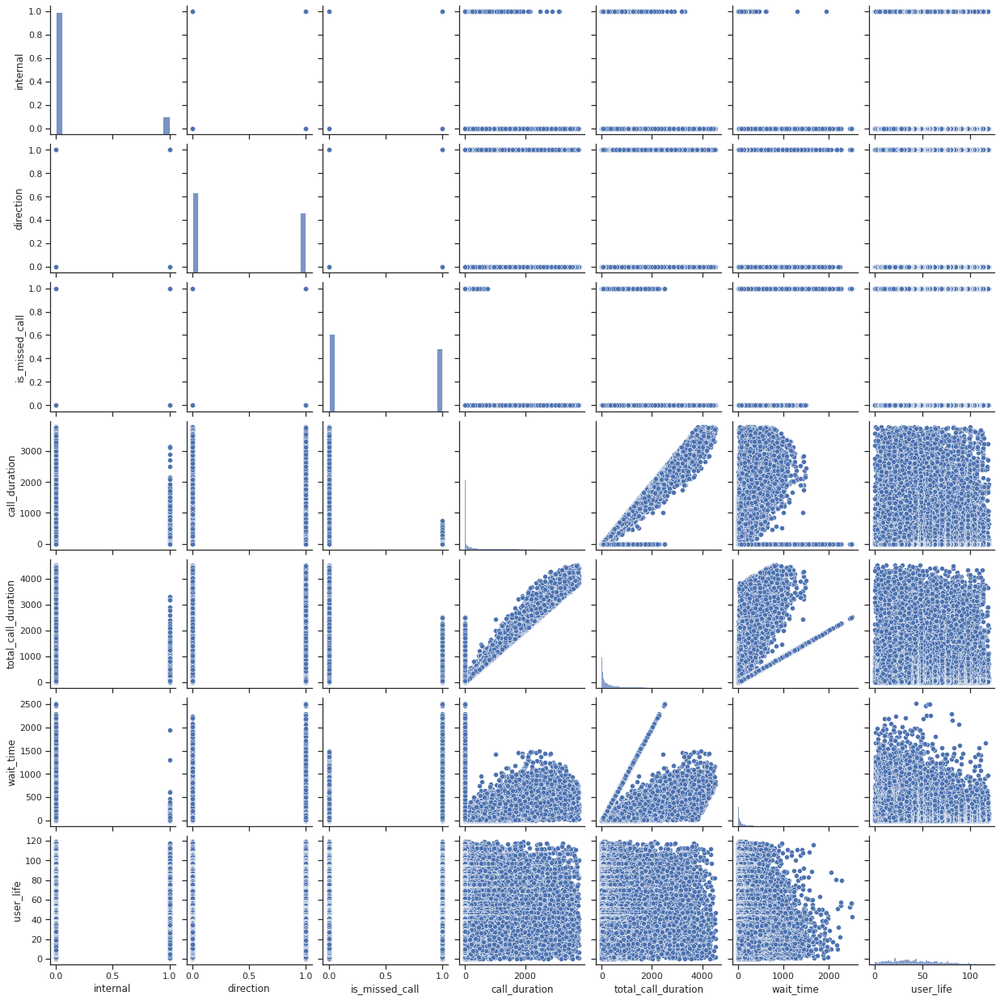

In [136]:
%%time
# Scatter matrix
plt.figure(figsize=(15, 8))
sns.set_theme(style="ticks")
sns.pairplot(telecom_upd[['internal','direction','is_missed_call',
                          'call_duration','total_call_duration','wait_time','user_life']])

- La duración de llamadas externas es mayor pero no por mucho márgen. En cambio, para el tiempo de espera si hay mayor diferencia, es ampliamente superior con los clientes.

- El tiempo de espera en llamadas perdidas (no concretadas) es mayor al tiempo de espera en llamadas cumplidas.

- Cuando el tiempo de llamada es de aproximadamente media hora (2000 segundos) los tiempos de espera que se producen son mayores.

- Los tiempos de espera para clientes con menos días es mayor y va descendiendo en la medida que pasa el tiempo. Esto está relacionado a los clientes que llegaron en octubre y noviembre, los cuales han tenido que esperar más producto de múltiples factores, entre ellos, aumento de demanda. 

#### Llamadas perdidas

Una de las principales variables a tener en cuenta para los operadores es su cantidad de llamadas perdidas, tanto las que reciben y no contestan como las que emiten y no tienen respuesta.

**Cantidades:**

In [137]:
# Creamos un query para llamadas perdidas y agrupamos por operador y fecha
miss_per_operator = telecom_upd.query('is_missed_call == 1').groupby(['operator_id','date']).agg({'calls_count':'sum'})
miss_per_operator = miss_per_operator.reset_index()
# Veamos las cantidades a través del tiempo(agrupamos por fecha y sacamos la media de la suma y del promedio diario)
miss_per_day = miss_per_operator.groupby('date').agg({'calls_count':['sum','mean']})
miss_per_day = miss_per_day.reset_index()
miss_per_day.columns = ['date','total_miss_calls','mean_miss_calls']

# Graficamos la suma de llamadas perdidas diarias
fig_miss_per_day = px.bar(miss_per_day, y='total_miss_calls', x='date', color_discrete_sequence=['indianred'])
fig_miss_per_day.update_layout(title='Cantidad de llamadas perdidas por día', 
                               xaxis_title='Fecha', yaxis_title='Cantidad de llamadas perdidas', height=500, width=800)
fig_miss_per_day.show()

- A partir de la última semana de septiembre, la cantidad de llamadas perdidas incrementa como mínimo en un 50%.
- Durante octubre se mantienen entorno a las 2000 y 2500 llamadas perdidas en total.
- Noviembre es el mes más crítico ya que pasan  de 2663 llamadas perdidas a un máximo de 4023.

Veamos la cantidad de operadores únicos para cada día:

In [138]:
# Agrupamos por fecha y contamos los operadores
unique_oper_misscalls = miss_per_operator.groupby('date').agg({'operator_id':'nunique'})
unique_oper_misscalls = unique_oper_misscalls.reset_index()
# Graficamos
fig_unique_oper_misscalls = px.bar(unique_oper_misscalls, y='operator_id', x='date', color_discrete_sequence=['blue'])
fig_unique_oper_misscalls.update_layout(title='Cantidad de operadores por día con llamadas perdidas', 
                               xaxis_title='Fecha', yaxis_title='Cantidad de operadores', height=500, width=800)
fig_unique_oper_misscalls.show()

**Podemos ver que la relación es similar, el aumento de cantidad de llamadas perdidas responde al aumento de la cantidad de operadores que participan.**

Calculemos la **relación semanal** de cantidad de llamadas perdidas por operador para así **establecer los parámetros comunes**.

#### Relación de llamadas perdidas semanales por operador

In [139]:
# Creamos un dataframe que alojará las características comunes de acuerdo a la semana
common_stats = pd.DataFrame()

In [140]:
# Agrupamos por semana las llamadas perdidas y sus distintas características
week1_miss_group = week1_aug.query(
                            'is_missed_call == 1').groupby([
                            'operator_id','internal','direction']).agg({'calls_count':'sum'})
week1_miss_group = week1_miss_group.reset_index()

# Volvemos a agrupar, ahora por internal y direction para calcular las medias y totales para la semana
week1_miss_group = week1_miss_group.groupby(['internal','direction']).agg({'calls_count':['mean','sum']})
week1_miss_group = week1_miss_group.reset_index()
week1_miss_group.columns = ['internal','direction','mean_calls','total_calls']
week1_miss_group

,internal,direction,mean_calls,total_calls
0,0,in,1.50,6
1,0,out,5.25,21
2,1,in,0.00,0
3,1,out,0.75,3


In [141]:
# Alojamos los datos en el dataframe
common_stats = common_stats.append({'miss_client_in_mean': week1_miss_group.loc[0,'mean_calls'],
                                    'miss_client_in_total': week1_miss_group.loc[0,'total_calls'],
                                    'miss_client_out_mean': week1_miss_group.loc[1,'mean_calls'],
                                    'miss_client_out_total': week1_miss_group.loc[1,'total_calls'],
                                    'miss_operator_in_mean': week1_miss_group.loc[2,'mean_calls'],
                                    'miss_operator_in_total': week1_miss_group.loc[2,'total_calls'],
                                    'miss_operator_out_mean': week1_miss_group.loc[3,'mean_calls'],
                                    'miss_operator_out_total': week1_miss_group.loc[3,'total_calls']}, 
                                    ignore_index=True)
common_stats

,miss_client_in_mean,miss_client_in_total,miss_client_out_mean,miss_client_out_total,miss_operator_in_mean,miss_operator_in_total,miss_operator_out_mean,miss_operator_out_total
0,1.5,6.0,5.25,21.0,0.0,0.0,0.75,3.0


**Crearemos un ciclo for para rellenar las cantidades de acuerdo a cada semana siguiendo el mismo proceso anterior:**

In [142]:
# Ciclo for para agrupar datos
#Lista de variables de cada semana
weeks = [week2_aug, week3_aug, week4_aug, week5_aug, 
         week1_sep, week2_sep, week3_sep, week4_sep,
         week1_oct, week2_oct, week3_oct, week4_oct, week5_oct,
         week1_nov, week2_nov, week3_nov, week4_nov]

for week in weeks:
    
    week_miss_group = week.query('is_missed_call == 1').groupby([
                            'operator_id','internal','direction']).agg({'calls_count':'sum'})
    week_miss_group = week_miss_group.reset_index()

    week_miss_group = week_miss_group.groupby(['internal','direction']).agg({'calls_count':['mean','sum']})
    week_miss_group = week_miss_group.reset_index()
    week_miss_group.columns = ['internal','direction','mean_calls','total_calls']

    # Alojamos los datos en el dataframe
    common_stats = common_stats.append({'miss_client_in_mean': week_miss_group.loc[0,'mean_calls'],
                                    'miss_client_in_total': week_miss_group.loc[0,'total_calls'],
                                    'miss_client_out_mean': week_miss_group.loc[1,'mean_calls'],
                                    'miss_client_out_total': week_miss_group.loc[1,'total_calls'],
                                    'miss_operator_in_mean': week_miss_group.loc[2,'mean_calls'],
                                    'miss_operator_in_total': week_miss_group.loc[2,'total_calls'],
                                    'miss_operator_out_mean': week_miss_group.loc[3,'mean_calls'],
                                    'miss_operator_out_total': week_miss_group.loc[3,'total_calls']}, 
                                    ignore_index=True)

In [143]:
# Agregamos una columna para identificar la semana
week_names=['week1_aug','week2_aug','week3_aug','week4_aug','week5_aug','week1_sep','week2_sep','week3_sep','week4_sep',
           'week1_oct','week2_oct','week3_oct','week4_oct','week5_oct', 'week1_nov','week2_nov','week3_nov','week4_nov']

common_stats.insert(0,'Week', week_names)


In [144]:
# vemos el dataframe de contador de llamadas perdidas por semana
common_stats.head()

,Week,miss_client_in_mean,miss_client_in_total,miss_client_out_mean,miss_client_out_total,miss_operator_in_mean,miss_operator_in_total,miss_operator_out_mean,miss_operator_out_total
0,week1_aug,1.500000,6.0,5.250000,21.0,0.000000,0.0,0.750000,3.0
1,week2_aug,5.222222,94.0,18.833333,339.0,0.666667,12.0,0.777778,14.0
2,week3_aug,18.291667,439.0,26.416667,634.0,0.708333,17.0,1.250000,30.0
3,week4_aug,15.634615,813.0,21.903846,1139.0,0.192308,10.0,0.288462,15.0
4,week5_aug,13.617978,1212.0,22.179775,1974.0,0.426966,38.0,0.707865,63.0


**Con esta tabla podemos establecer parametros comunes de acuerdo a la cantidad de llamadas perdidas.**

Relacionemos los valores a la eficiencia que pueden alcanzar los operadores, para esto descartaremos las llamadas que no conteste el cliente o las llamadas que no contestan otros operadores porque son factores que dejan de depender del operador propiamente tal.

Redondearemos las medias para obtener la cantidad normal:

In [145]:
# Vemos los valores normales
normal_oper_miss = common_stats[['Week','miss_client_in_mean', 'miss_operator_in_mean']].copy()
normal_oper_miss['miss_client_in_mean'] = normal_oper_miss['miss_client_in_mean'].round().astype('int')
normal_oper_miss['miss_operator_in_mean'] = normal_oper_miss['miss_operator_in_mean'].round().astype('int')
normal_oper_miss.head()

,Week,miss_client_in_mean,miss_operator_in_mean
0,week1_aug,2,0
1,week2_aug,5,1
2,week3_aug,18,1
3,week4_aug,16,0
4,week5_aug,14,0


**Ya tenemos lista una tabla con los valores normales para utilizar en la construcción de métricas de eficiencia.**

#### Tiempo de espera 

Tenemos nuestra columna *wait_time* para analizar los valores a través del tiempo. Para enfocarnos en el rendimiento de los operadores, tomaremos en cuenta solo el tiempo de espera para las llamadas entrantes, es decir, las que reciben los operadores.

*Nota: recordamos que las llamadas entrantes las dejamos con un valor direction = 1*

In [146]:
# Agrupamos por operador y fecha y sumamos el tiempo de espera total
wait_per_operator = telecom_upd.query('direction == 1').groupby(['operator_id','date']).agg({'wait_time':'sum'})
wait_per_operator = wait_per_operator.reset_index()

# Veamos las cantidades a través del tiempo(agrupamos por fecha y sacamos la media de la suma y del promedio diario)
wait_per_day = wait_per_operator.groupby('date').agg({'wait_time':['sum','mean']})
wait_per_day = wait_per_day.reset_index()
wait_per_day.columns = ['date','total_wait_time','mean_wait_time']

# Graficamos la suma de llamadas perdidas diarias
fig_wait_per_day = px.bar(wait_per_day, y='total_wait_time', x='date', color_discrete_sequence=['indianred'])
fig_wait_per_day.update_layout(title='Tiempo total de espera por día en llamadas recibidas', 
                               xaxis_title='Fecha', yaxis_title='Tiempo de espera', height=500, width=800)
fig_wait_per_day.show()

*Los tiempos de espera corresponden al total por día en llamadas recibidas.*

- En septiembre, de tener cifras totales de espera de 5 mil segundos, se pasó a tener casi 19 mil (83 minutos a poco más de 5 horas; es decir, se cuatriplicó la espera.
- Durante octubre las esperas van desde 20 mil a 30 mil segundos aproximadamente (5 horas a 8 horas). La proporción no es tan elevada como en septiembre.
- Durante noviembre, comienza cercano a los 30 mil y pasa levemente los 40 mil (8 a 11 horas), Manteniendo una subida de tiempo de espera similar al mes anterior.

#### Relación de tiempos de espera semanales por operador

In [147]:
# Creamos un dataframe que alojará las características comunes de acuerdo a la semana
common_wait_stats = pd.DataFrame()

In [148]:
# Hacemos el ejercicio para el primer grupo
week1_wait_group = week1_aug.query('direction == "in"').groupby(['operator_id','internal']).agg({'wait_time':'sum'})
week1_wait_group = week1_wait_group.reset_index()

week1_wait_group = week1_wait_group.groupby('internal').agg({'wait_time':['mean','sum']})
week1_wait_group = week1_wait_group.reset_index()
week1_wait_group.columns = ['internal','mean_wait','total_wait']

# agregamos datos al dataframe
common_wait_stats = common_wait_stats.append({'wait_client_mean': week1_wait_group.loc[0,'mean_wait'],
                                              'wait_client_total': week1_wait_group.loc[0,'total_wait']}, 
                                              ignore_index=True)

In [149]:
# Ciclo for para agrupar datos
for week in weeks:
    
    week_wait_group = week.query('direction == "in"').groupby(['operator_id','internal']).agg({'wait_time':'sum'})
    week_wait_group = week_wait_group.reset_index()

    week_wait_group = week_wait_group.groupby('internal').agg({'wait_time':['mean','sum']})
    week_wait_group = week_wait_group.reset_index()
    week_wait_group.columns = ['internal','mean_wait','total_wait']

    # Alojamos los datos en el dataframe
    common_wait_stats = common_wait_stats.append({'wait_client_mean': week_wait_group.loc[0,'mean_wait'],
                                                  'wait_client_total': week_wait_group.loc[0,'total_wait'],
                                                  'wait_operator_mean': week_wait_group.loc[1,'mean_wait'],
                                                  'wait_operator_total': week_wait_group.loc[1,'total_wait']}, 
                                                  ignore_index=True)

In [150]:
# Agregamos una columna para identificar la semana
common_wait_stats.insert(0,'Week', week_names)

In [151]:
# vemos el dataframe de contador de tiempos de espera  por semana
common_wait_stats.head()

,Week,wait_client_mean,wait_client_total,wait_operator_mean,wait_operator_total
0,week1_aug,17.500000,35.0,NaN,NaN
1,week2_aug,113.800000,1138.0,168.333333,505.0
2,week3_aug,203.130435,4672.0,136.666667,410.0
3,week4_aug,288.160000,14408.0,39.000000,78.0
4,week5_aug,254.554217,21128.0,73.000000,365.0


In [152]:
# Rellenamos valores ausentes con 0
common_wait_stats = common_wait_stats.fillna(0) 

**Ya tenemos una tabla con los valores medios por cada semana.** De estos valores tomemos las medias para calcular más adelante la eficiencia por operador. El tiempo que esperan los clientes y el tiempo que esperan otros operadores.



In [153]:
# Vemos los valores normales
normal_oper_wait = common_wait_stats[['Week','wait_client_mean', 'wait_operator_mean']].copy()
normal_oper_wait['wait_client_mean'] = normal_oper_wait['wait_client_mean'].round().astype('int')
normal_oper_wait['wait_operator_mean'] = normal_oper_wait['wait_operator_mean'].round().astype('int')
normal_oper_wait.head()

,Week,wait_client_mean,wait_operator_mean
0,week1_aug,18,0
1,week2_aug,114,168
2,week3_aug,203,137
3,week4_aug,288,39
4,week5_aug,255,73


**Ya tenemos lista una tabla con los valores normales para utilizar en la construcción de métricas de eficiencia.**

#### Cantidad de llamadas salientes

**La cantidad de llamadas que emite un operador puede reflejar la cantidad de intentos necesarios para resolver un problema**, ya sea con un cliente u operador. Un número reducido en cantidad de llamadas emitidas podría ser indicador de que el operador es eficiente. Veamos el detalle del total de llamadas emitidas a través del tiempo.

*Nota: ya hemos considerado la cantidad de llamadas perdidas, ahora veremos la cantidad de llamadas completadas hechas por cada operador.*


In [154]:
# Creamos un query para llamadas emitidas y agrupamos por operador y fecha
call_per_operator = telecom_upd.query('is_missed_call == 0 and direction == 0').groupby(['operator_id','date']).agg({'calls_count':'sum'})
call_per_operator = call_per_operator.reset_index()
# Veamos las cantidades a través del tiempo(agrupamos por fecha y sacamos la media de la suma y del promedio diario)
call_per_day = call_per_operator.groupby('date').agg({'calls_count':['sum','mean']})
call_per_day = call_per_day.reset_index()
call_per_day.columns = ['date','total_calls','mean_calls']

# Graficamos la suma de llamadas perdidas diarias
fig_call_per_day = px.bar(call_per_day, y='total_calls', x='date', color_discrete_sequence=['indianred'])
fig_call_per_day.update_layout(title='Cantidad total de llamadas emitidas por día', 
                               xaxis_title='Fecha', yaxis_title='Cantidad de llamadas', height=500, width=800)
fig_call_per_day.show()

- La cantidad de llamadas emitidas en septiembre aumenta desde 600 hasta llegar a valores cercanos a 1200.
- El crecimiento en octubre va desde las 1200 llamadas aproximadamente hasta las 2200; un aumento de 1000 llamadas.
- La primera semana de noviembre comienza con cerca de 2100 llamadas un día viernes; y al día lunes siguiente, se produce un salto hacia 2800 llamadas. Es el crecimiento más importante ya que después durante todo el mes seguiría subiendo de forma normal hasta llegar a 3500 aproximadamente.

#### Relación de llamadas emitidas semanales por operador

In [155]:
# Creamos un dataframe que alojará las características comunes de acuerdo a la semana
common_call_stats = pd.DataFrame()

In [156]:
# Agrupamos por semana las llamadas emitidas y sus distintas características
week1_call_group = week1_aug.query('is_missed_call == 0 and direction == "out"').groupby(
                                    ['operator_id','internal']).agg({'calls_count':'sum'})
week1_call_group = week1_call_group.reset_index()

# Volvemos a agrupar, ahora por internal  para calcular las medias y totales para la semana
week1_call_group = week1_call_group.groupby(['internal']).agg({'calls_count':['mean','sum']})
week1_call_group = week1_call_group.reset_index()
week1_call_group.columns = ['internal','mean_calls','total_calls']
week1_call_group

,internal,mean_calls,total_calls
0,0,11.0,22
1,1,1.5,3


In [157]:
# Alojamos los datos en el dataframe
common_call_stats = common_call_stats.append({'calls_client_mean': week1_call_group.loc[0,'mean_calls'],
                                              'calls_client_total': week1_call_group.loc[0,'total_calls'],
                                              'calls_operator_mean': week1_call_group.loc[1,'mean_calls'],
                                              'calls_operator_total': week1_call_group.loc[1,'total_calls']}, 
                                              ignore_index=True)
common_call_stats

,calls_client_mean,calls_client_total,calls_operator_mean,calls_operator_total
0,11.0,22.0,1.5,3.0


**Crearemos un ciclo for para rellenar las cantidades de acuerdo a cada semana siguiendo el mismo proceso anterior:**

In [158]:
# Ciclo for para agrupar datos
for week in weeks:
    
    week_calls_group = week.query('is_missed_call == 0 and direction == "out"').groupby(
                                    ['operator_id','internal']).agg({'calls_count':'sum'})
    week_calls_group = week_calls_group.reset_index()

    week_calls_group = week_calls_group.groupby(['internal']).agg({'calls_count':['mean','sum']})
    week_calls_group = week_calls_group.reset_index()
    week_calls_group.columns = ['internal','mean_calls','total_calls']

    # Alojamos los datos en el dataframe
    common_call_stats = common_call_stats.append({'calls_client_mean': week_calls_group.loc[0,'mean_calls'],
                                                  'calls_client_total': week_calls_group.loc[0,'total_calls'],
                                                  'calls_operator_mean': week_calls_group.loc[1,'mean_calls'],
                                                  'calls_operator_total': week_calls_group.loc[1,'total_calls']}, 
                                                   ignore_index=True)

In [159]:
# Agregamos una columna para identificar la semana
common_call_stats.insert(0,'Week', week_names)

In [160]:
# vemos el dataframe de contador de llamadas emitidas por semana
common_call_stats.head()

,Week,calls_client_mean,calls_client_total,calls_operator_mean,calls_operator_total
0,week1_aug,11.000000,22.0,1.500000,3.0
1,week2_aug,19.538462,254.0,3.500000,7.0
2,week3_aug,48.947368,930.0,3.000000,3.0
3,week4_aug,31.200000,1404.0,1.200000,6.0
4,week5_aug,25.036145,2078.0,4.833333,29.0


**Con esta tabla podemos establecer parametros comunes de acuerdo a la cantidad de llamadas emitidas.**

Redondearemos las medias para obtener la cantidad normal:

In [161]:
# Vemos los valores normales
normal_oper_calls = common_call_stats[['Week','calls_client_mean', 'calls_operator_mean']].copy()
normal_oper_calls['calls_client_mean'] = normal_oper_calls['calls_client_mean'].round().astype('int')
normal_oper_calls['calls_operator_mean'] = normal_oper_calls['calls_operator_mean'].round().astype('int')
normal_oper_calls.head()

,Week,calls_client_mean,calls_operator_mean
0,week1_aug,11,2
1,week2_aug,20,4
2,week3_aug,49,3
3,week4_aug,31,1
4,week5_aug,25,5


**Ya tenemos lista una tabla con los valores normales para utilizar en la construcción de métricas de eficiencia.**

### Construcción de métricas de eficiencia

De acuerdo al análisis de las variables tenemos seis características básicas con sus tablas de medias normales según cada semana. Las características que observamos son:

    1. Cantidad de llamadas perdidas de clientes
    2. Cantidad de llamadas perdidas de operadores
    3. Tiempo de espera en llamadas de clientes
    4. Tiempo de espera en llamadas de operadores
    5. Cantidad de llamadas a clientes
    6. Cantidad de llamadas a operadores

**Un operador eficiente será el que pueda tener una menor cantidad de llamadas perdidas, un menor tiempo de de espera y una menor cantidad de llamadas a clientes.**

Dado que cada semana presenta un patrón distinto pero **los cambios más fuertes se producen entre los distintos meses**, **compararemos el rendimiento de cada operador en cada mes.**

**Comparar los datos de rendimiento de casa semana se puede tornar muy lento de procesar y no es necesario teniendo en cuenta que un tiempo de comparación de una semana sería demasiado acotado.**


*¿Cómo lo haremos?*

- Buscaremos si el operador pertenece a grupos mensuales; de estar involucrado, se comparará su registro mensual con la media. 
- Si participa en el mes, acumulará un punto de participación.
- Si su valor es menor o igual a la media, acumulará puntos de rendimiento.
- Los puntos de rendimiento serán distintos dependiendo si la relación es con el cliente u operador. La satisfacción del cliente debiera tener mayor relevancia en la eficiencia del operador, por lo tanto, se asignarán 2 puntos de rendimiento a las pruebas de clientes y un punto por las pruebas de operador. 
- El máximo de puntos de participación será de 4 (uno por cada mes).
- El máximo de puntos de rendimiento será de 9.
- Los puntos positivos estarán asociados con un valor de 1; en caso de no haber, un 0.

*Nota: en el estudio de datos observamos que no todos los operadores realizan las mismas funciones, pero no tenemos la certeza de que esto realmente sea así, pueden ser muchas las razones. Si observamos tiempos o cantidad de llamada iguales a 0 para algunos operadores, no necesariamente significa que no realicen la tarea, si no que su desempeño ha sido bueno y no han tenido tiempos de espera por ejemplo o no han tenido llamadas perdidas. Por lo tanto, a todos los operadores los evaluaremos por igual, con la única diferencia de tener en cuenta el mes de trabajo.*

#### Actualización de datos mensuales

**Tabla de valores normales en llamadas perdidas:**

In [162]:
# Creamos un dataframe para los totales
total_normal_oper_miss = pd.DataFrame(columns=['month','miss_client_in_mean','miss_operator_in_mean'])
total_normal_oper_miss['month'] =['August','September','October','November']

# Agosto
aug_n = normal_oper_miss.iloc[range(5)].mean().round().astype('int')
total_normal_oper_miss.loc[0,'miss_client_in_mean'] = aug_n['miss_client_in_mean']
total_normal_oper_miss.loc[0,'miss_operator_in_mean'] = aug_n['miss_operator_in_mean']

# septiembre
sep_n = normal_oper_miss.iloc[range(5,9)].mean().round().astype('int')
total_normal_oper_miss.loc[1,'miss_client_in_mean'] = sep_n['miss_client_in_mean']
total_normal_oper_miss.loc[1,'miss_operator_in_mean'] = sep_n['miss_operator_in_mean']

# octubre
oct_n = normal_oper_miss.iloc[range(9,14)].mean().round().astype('int')
total_normal_oper_miss.loc[2,'miss_client_in_mean'] = oct_n['miss_client_in_mean']
total_normal_oper_miss.loc[2,'miss_operator_in_mean'] = oct_n['miss_operator_in_mean']

# noviembre
nov_n = normal_oper_miss.iloc[range(14,18)].mean().round().astype('int')
total_normal_oper_miss.loc[3,'miss_client_in_mean'] = nov_n['miss_client_in_mean']
total_normal_oper_miss.loc[3,'miss_operator_in_mean'] = nov_n['miss_operator_in_mean']

In [163]:
# Vemos los valores normales de llamadas no contestadas
total_normal_oper_miss

,month,miss_client_in_mean,miss_operator_in_mean
0,August,11,0
1,September,10,0
2,October,10,0
3,November,11,0


**Tabla de valores normales en tiempos de espera:**

In [164]:
# Creamos un dataframe para los totales
total_normal_oper_wait = pd.DataFrame(columns=['month','wait_client_mean','wait_operator_mean'])
total_normal_oper_wait['month'] =['August','September','October','November']

# Agosto
aug_n = normal_oper_wait.iloc[range(5)].mean().round().astype('int')
total_normal_oper_wait.loc[0,'wait_client_mean'] = aug_n['wait_client_mean']
total_normal_oper_wait.loc[0,'wait_operator_mean'] = aug_n['wait_operator_mean']

# septiembre
sep_n = normal_oper_wait.iloc[range(5,9)].mean().round().astype('int')
total_normal_oper_wait.loc[1,'wait_client_mean'] = sep_n['wait_client_mean']
total_normal_oper_wait.loc[1,'wait_operator_mean'] = sep_n['wait_operator_mean']

# octubre
oct_n = normal_oper_wait.iloc[range(9,14)].mean().round().astype('int')
total_normal_oper_wait.loc[2,'wait_client_mean'] = oct_n['wait_client_mean']
total_normal_oper_wait.loc[2,'wait_operator_mean'] = oct_n['wait_operator_mean']

# noviembre
nov_n = normal_oper_wait.iloc[range(14,18)].mean().round().astype('int')
total_normal_oper_wait.loc[3,'wait_client_mean'] = nov_n['wait_client_mean']
total_normal_oper_wait.loc[3,'wait_operator_mean'] = nov_n['wait_operator_mean']

In [165]:
# Vemos los valores normales de tiempos de espera
total_normal_oper_wait

,month,wait_client_mean,wait_operator_mean
0,August,176,83
1,September,351,121
2,October,500,55
3,November,487,88


In [166]:
# Creamos un dataframe para los totales
total_normal_oper_calls = pd.DataFrame(columns=['month','calls_client_mean','calls_operator_mean'])
total_normal_oper_calls['month'] =['August','September','October','November']

# Agosto
aug_n = normal_oper_calls.iloc[range(5)].mean().round().astype('int')
total_normal_oper_calls.loc[0,'calls_client_mean'] = aug_n['calls_client_mean']
total_normal_oper_calls.loc[0,'calls_operator_mean'] = aug_n['calls_operator_mean']

# septiembre
sep_n = normal_oper_calls.iloc[range(5,9)].mean().round().astype('int')
total_normal_oper_calls.loc[1,'calls_client_mean'] = sep_n['calls_client_mean']
total_normal_oper_calls.loc[1,'calls_operator_mean'] = sep_n['calls_operator_mean']

# octubre
oct_n = normal_oper_calls.iloc[range(9,14)].mean().round().astype('int')
total_normal_oper_calls.loc[2,'calls_client_mean'] = oct_n['calls_client_mean']
total_normal_oper_calls.loc[2,'calls_operator_mean'] = oct_n['calls_operator_mean']

# noviembre
nov_n = normal_oper_calls.iloc[range(14,18)].mean().round().astype('int')
total_normal_oper_calls.loc[3,'calls_client_mean'] = nov_n['calls_client_mean']
total_normal_oper_calls.loc[3,'calls_operator_mean'] = nov_n['calls_operator_mean']

In [167]:
# Vemos los valores normales para llamadas emitidas
total_normal_oper_calls

,month,calls_client_mean,calls_operator_mean
0,August,27,3
1,September,30,7
2,October,31,7
3,November,37,8


Mostremos un gráfico con estos valores normales por mes:

In [168]:
# Gráfico de barras de cantidad de llamadas emitidas y perdidas normales por mes
fig_normal_calls = go.Figure()

fig_normal_calls.add_trace(go.Bar(
    x=['Agosto','Septiembre','Octubre','Noviembre'], 
    y= [27,30,31,37],  
    name= 'Llamadas emitidas a clientes',
    marker_color='forestgreen'))

fig_normal_calls.add_trace(go.Bar(
    x=['Agosto','Septiembre','Octubre','Noviembre'], 
    y= [3,7,7,8],  
    name= 'Llamadas emitidas a operadores',
    marker_color='blue'))
                                    
fig_normal_calls.add_trace(go.Bar(
    x=['Agosto','Septiembre','Octubre','Noviembre'], 
    y= [11,10,10,11],
    name= 'Llamadas no contestadas a clientes',
    marker_color='indianred'))

fig_normal_calls.add_trace(go.Bar(
    x=['Agosto','Septiembre','Octubre','Noviembre'], 
    y= [1,0,0,0],
    name= 'Llamadas no contestadas a operadores',
    marker_color='purple'))


fig_normal_calls.update_layout(title='Media de llamadas emitidas y perdidas por operador de forma mensual',
                                 legend_title_text='Tipo de llamada', yaxis_title='Cantidad de llamadas')

fig_normal_calls.show()

- La cantidad de llamadas emitidas a clientes subió desde agosto a noviembre en 10 por operador.
- La cantidad de llamadas a operadores fue más baja en agosto pero luego se mantuvo cercano a 7 para los otros meses.
- Las llamadas perdidas de clientes se mantuvieron en torno a 11 por operador cada mes.
- Llamadas perdidas de otros operadores en general solo hubo para agosto.

Veamos para el tiempo de espera:

In [169]:
# Gráfico de barras de tiempo de espera por mes
fig_wait_time = go.Figure()
fig_wait_time.add_trace(go.Bar(
    x=['Agosto','Septiembre','Octubre','Noviembre'], 
    y= [176,351,500,487],  
    name= 'Tiempo de espera de clientes',
    marker_color='indianred'))

fig_wait_time.add_trace(go.Bar(
    x=['Agosto','Septiembre','Octubre','Noviembre'], 
    y= [80,122,54,88],  
    name= 'Tiempo de espera de otros operadores',
    marker_color='darkmagenta'))

fig_wait_time.update_layout(title='Media de tiempos de espera por operador en llamadas recibidas de forma mensual',
                                 legend_title_text='Dirección de la llamada', yaxis_title='Tiempo en segundos')

fig_wait_time.show()

- El tiempo que tuvieron que esperar los clientes aumento considerablemente hacia septiembre y alcanzó su máximo en octubre.
- Las esperas en agosto de los clientes fueron de 3 minutos por operador y llegaron hasta 8 minutos en octubre y noviembre.
- En cuanto a otros operadores, las esperas fueron bastante más bajas y se mantuvieron entre 1 y dos minutos para todo el periodo.

**Ya tenemos nuestras 3 tablas con los datos de cada mes, ahora podemos relacionar estos números con el desempeño de cada operador.** Ahora, crearemos los 4 dataset con los registros de cada mes:

In [170]:
#Querys para los meses
august_telecom = telecom_upd.query('date <= "2019-08-31"')
september_telecom = telecom_upd.query('"2019-09-01" <= date <= "2019-09-30"')
october_telecom = telecom_upd.query('"2019-10-01" <= date <= "2019-10-31"')
november_telecom = telecom_upd.query('"2019-11-01" <= date <= "2019-11-30"')

**Añadimos los valores medios a los querys mensuales:**

In [171]:
# ignoramos warnings de alertas por aplicar valores con loc a toda una columna
import warnings
warnings.filterwarnings('ignore')

# Lista de querys mensuales
op_months = [august_telecom, september_telecom, october_telecom, november_telecom]

#Creamos un contador para recorrer el número de mes
count = 0

# ciclo for para agregar valores medios a cada semana
for month in op_months:
    
    month['miss_client_in_mean'] = total_normal_oper_miss.loc[count,'miss_client_in_mean']
    month['miss_operator_in_mean'] = total_normal_oper_miss.loc[count,'miss_operator_in_mean']

    month['wait_client_mean'] = total_normal_oper_wait.loc[count,'wait_client_mean']
    month['wait_operator_mean'] = total_normal_oper_wait.loc[count,'wait_operator_mean']

    month['calls_client_mean'] = total_normal_oper_calls.loc[count,'calls_client_mean']
    month['calls_operator_mean'] = total_normal_oper_calls.loc[count,'calls_operator_mean']
    
    count += 1

#### Sistema de asignación de puntos de rendimiento y participación

In [172]:
# Creamos un dataframe con el id de operadores para la signación de puntos
operator_points = pd.DataFrame(columns=['operator_id','job_time','performance'])

# Asignamos los valores de los operadores
operator_points['operator_id'] = telecom_upd['operator_id'].unique()

# Asignamos los operadores como índice para usar en ciclo for
operator_points = operator_points.set_index(['operator_id'])

In [173]:
# Rellenamos los valores de operator_points para que el ciclo pueda ejecutar la suma
operator_points = operator_points.fillna(0)

In [174]:
# Prueba de participación
for o in operator_points.index:
    for month in op_months:
        
        if o in month['operator_id'].unique():
            operator_points.loc[o,'job_time'] += 1

<div class="alert alert-block alert-info">
<b>El ciclo siguiente puede tardar entre 1 a 2 minutos en ejecutarse.</b> <a class="tocSkip"></a>
</div>

In [175]:
%%time

# Prueba de rendimiento
for o in operator_points.index:    
    for month in op_months:
        
        if o in month['operator_id'].unique():
        
            # Prueba 1: Cantidad de llamadas perdidas de clientes
            if month.query('operator_id == @o and is_missed_call == 1 and internal== 0 and direction == 1')[
                'calls_count'].sum() <= month['miss_client_in_mean'].mean():         #condición: si es menor a la media
                operator_points.loc[o,'performance'] += 2

            # Prueba 2: Cantidad de llamadas perdidas de operadores   
            if month.query('operator_id == @o and is_missed_call == 1 and internal== 1 and direction == 1')[
                'calls_count'].sum() <= month['miss_operator_in_mean'].mean():         
                operator_points.loc[o,'performance'] += 1
            
            #  Prueba 3: Tiempo de espera en llamadas de clientes   
            if month.query('operator_id == @o and internal== 0 and direction == 1')[
                'wait_time'].sum() <= month['wait_client_mean'].mean():         
                operator_points.loc[o,'performance'] += 2

            # Prueba 4: Tiempo de espera en llamadas de operadores   
            if month.query('operator_id == @o and internal== 1 and direction == 1')[
                'wait_time'].sum() <= month['wait_operator_mean'].mean():         
                operator_points.loc[o,'performance'] += 1
            
            # Prueba 5: Cantidad de llamadas a clientes   
            if month.query('operator_id == @o and is_missed_call == 0 and internal== 0 and direction == 0')[
                'calls_count'].sum() <= month['calls_client_mean'].mean():         
                operator_points.loc[o,'performance'] += 2
            
            # Prueba 6: Cantidad de llamadas a operadores
            if month.query('operator_id == @o and is_missed_call == 0 and internal== 1 and direction == 0')[
                'calls_count'].sum() <= month['calls_operator_mean'].mean():         
                operator_points.loc[o,'performance'] += 1
            

CPU times: user 59.9 s, sys: 10.5 ms, total: 59.9 s
Wall time: 1min


In [176]:
# Veamos los primeros valores de la tabla
operator_points.head(10)

,job_time,performance
operator_id,,
0,4,10
880022,4,34
880020,3,27
881278,3,27
880028,4,28
880026,4,28
882476,3,27
882478,1,9
886892,1,9


- El máximo de puntos de participación son 4,
- El máximo de puntos para el rendimiento es de 9 por cada mes, 36 como máximo si participa los 4 meses.

Para ser justos con aquellos que están involucrados en menos meses, dividiremos la cantidad total de puntos de performance por la cantidad de puntos de participación. Esto nos dará un puntaje que servirá para clasificar de mejor forma a nuestros operadores eficientes/ineficientes.

In [177]:
# Creamos columna score
operator_points['score'] = operator_points['performance'] / operator_points['job_time']
#Vemos como queda la tabla
operator_points.head()

,job_time,performance,score
operator_id,,,
0,4,10,2.5
880022,4,34,8.5
880020,3,27,9.0
881278,3,27,9.0
880028,4,28,7.0


#### Análisis de las puntuaciones

Veamos con el método describe las estadísticas de las puntuaciones obtenidas:

In [178]:
# Estadísticas de las puntuaciones obtenidas
operator_points.describe()

,job_time,performance,score
count,1093.000000,1093.000000,1093.000000
mean,1.934126,15.133577,7.974535
std,0.911494,7.073560,1.297495
min,1.000000,3.000000,2.500000
25%,1.000000,9.000000,7.000000
50%,2.000000,14.000000,9.000000
75%,2.000000,18.000000,9.000000
max,4.000000,36.000000,9.000000


**El máximo score posible es 9; esto implica que el rendimiento por mes está dentro de lo esperable o es mucho mejor.**

- Al menos el 75% de operadores ha estado presente en 2 meses o uno solo.
- Al menos el 50% de los operadores ha conseguido 14 puntos de desempeño.

*Nota: recordamos que los puntos de desempeño están compuestos del puntaje de 6 tipos de trabajo (3 relacionadas al cliente y 3 al operador) donde los relacionados al cliente valen 2 puntos y los de operadores 1 punto.*

- Al menos la mitad de usuarios alcanzó un rendimiento esperable o mejor.
- un 25% tuvo un score entre 7 y 9 y otro 25% fue bajo los 7 puntos.

#### Umbrales de eficiencia

Veamos la proporción de operadores en un gráfico:

In [179]:
# Vemos la cantidad de usuarios para los 5 mejores score
operator_points['score'].value_counts().head()

9.0    547
7.0    184
8.0    120
6.0     43
5.0     35
Name: score, dtype: int64

Para efectos del gráfico, agruparemos todos los operadores que obtuvieron menos de 7, lo que entraría en el 25% más bajo.

In [180]:
# Cntidad de operadores con menos de 7 de puntaje
operator_points[operator_points['score'] < 7]['score'].count()

156

In [181]:
# Creamos el gráfico
operator_points_fig = px.pie(operator_points, names= ['Score 9: rendimiento esperado',
                                                      'Score 8: levemente deficiente',
                                                      'Score 7: rendimiento deficiente',
                                                      'Score < 7: rendimiento malo'], 
                           values= [547,120,184,156], 
                    title='Proporción de operadores según el rendimiento',
                    color_discrete_sequence= px.colors.qualitative.Pastel
                    )
operator_points_fig.update_layout(legend_title_text='Grupo de rendimiento', height=400, width=700)
operator_points_fig.update_traces(textposition='inside', textinfo='percent')
operator_points_fig.show()

**Clasificamos de acuerdo a los puntajes en 4 tipos de operador:**
- Rendimiento esperado o mejor: 54% de los operadores
- Rendimiento levemente deficiente: 12% de los operadores
- Rendimiento deficiente: casi el 20% de los operadores
- Rendimiento malo: Casi un 16% de los operadores

Teniendo en cuenta las proporciones, el sistema de puntuación en base a distintas pruebas; siendo estrictos tendríamos que catalogar solo al grupo de score 9 como eficiente, en el que entraría poco más de la mitad de operadores.

Pero si tenemos consideración de que posiblemente no todos deban cumplir las mismas tareas, como por ejemplo, acumular menos puntaje solo por relacionarse exclusivamente con operadores; debemos establecer un **márgen de tolerancia**, en este caso, aceptar los que son levemente deficientes. De esta forma, un **66,2% de los operadores** calzaría en este rango de **operadores eficientes**.

Agregamos una columna a nuestra tabla de puntos y para aquellos operadores que tengan menos de 8 puntos, se les catalogará con un 0 como representación de ineficiencia. Para los que tengan 8 o 9, se les asignará un 1.

In [182]:
# Aplicamos la catalogación de eficiente/deficiente
for i in operator_points.index: 
    if operator_points.loc[i,'score'] > 7: 
        operator_points.loc[i,'efficient'] = 1
    else:
        operator_points.loc[i,'efficient'] = 0 

In [183]:
# Cambiamos los valores a enteros
operator_points['efficient'] = operator_points['efficient'].astype('int')
# Vemos la tabla
operator_points.head()

,job_time,performance,score,efficient
operator_id,,,,
0,4,10,2.5,0
880022,4,34,8.5,1
880020,3,27,9.0,1
881278,3,27,9.0,1
880028,4,28,7.0,0


### Pruebas de hipótesis

*¿Cuántos operadores hemos catalogado como eficientes/ineficientes?*

Veamos el conteo con el método value_counts.

In [184]:
# cantidad de operadores eficientes/ineficientes
operator_points['efficient'].value_counts()

1    753
0    340
Name: efficient, dtype: int64

**Tenemos 753 operadores catalogados como eficientes y 340 como ineficientes, es decir, al menos cada dos operadores con un buen rendimiento hay uno que no está teniendo un buen desempeño de acuerdo a la media de cada mes.**

#### Hipótesis a probar

*¿Podemos confirmar que los grupos se dividieron adecuadamente?*

Para confirmar esto haremos **pruebas de hipótesis** estableciendo que:

1. La cantidad de llamadas perdidas en operadores eficientes es menor a los del grupo de operadores ineficientes.
2. El tiempo de espera en llamadas que reciben los operadores es menor para los trabajadores eficientes respecto a los ineficientes.
3. La cantidad de llamadas emitidas de operadores eficientes es menor a la cantidad de los operadores ineficientes.

Para comparar estas medias de los grupos:
- Separarémos el dataset principal para operadores eficientes e ineficientes. 
- Filtraremos los datos de acuerdo a cada una de las 3 condiciones(llamadas perdidas entrantes, tiempo de espera y llamadas emitidas).
- Ocuparemos las columnas calls_count y wait time como serie de todo el registro para comparar las medias poblacionales.

#### Separación de grupos poblacionales

In [185]:
# Creamos variables donde almacenamos la lista de tipo de operador
efficient_operators = operator_points.query('efficient == 1').index
inefficient_operators = operator_points.query('efficient == 0').index

In [186]:
# Creamos querys de cada tipo de operador para todo el registro
efficient_telecom = telecom_upd.query('operator_id in @efficient_operators')
inefficient_telecom = telecom_upd.query('operator_id in @inefficient_operators')

In [187]:
# Serie de llamadas perdidas para operadores eficientes
eff_miss_calls = efficient_telecom.query('is_missed_call == 1 and direction == 1')['calls_count']
# Serie de llamadas perdidas para operadores ineficientes
ineff_miss_calls = inefficient_telecom.query('is_missed_call == 1 and direction == 1')['calls_count']

# Serie de tiempo de espera para operadores eficientes
eff_wait_time = efficient_telecom.query('direction == 1')['wait_time']
# Serie de tiempo de espera para operadores ineficientes
ineff_wait_time = inefficient_telecom.query('direction == 1')['wait_time']

# Serie de llamadas emitidas para operadores eficientes
eff_calls = efficient_telecom.query('is_missed_call == 0 and direction == 0')['calls_count']
# Serie de llamadas emitidas para operadores ineficientes
ineff_calls = inefficient_telecom.query('is_missed_call == 0 and direction == 0')['calls_count']

#### Pruebas de hipótesis

#####  Pruebas de Levene

Realizaremos la prueba de Levene para determinar nuestro valor "equal_var" a ser utilizado en las pruebas t.

**Nuestra hipótesis nula será que las varianzas de la cantidad de llamadas en ambos dataframes son iguales.**

Fijaremos un nivel de significancia de 1%, es decir, si la probabilidad es menor al 1%, estamos dispuestos a rechazar nuestra hiótesis nula ya que el valor real resultó estar muy lejos del propuesto. 

In [188]:
# Prueba de Levene cantidad de llamadas perdidas
miss_calls_levene = st.levene(eff_miss_calls, ineff_miss_calls, center='mean')
miss_calls_levene.pvalue

2.8142534771230504e-18

In [189]:
# Prueba de Levene tiempos de espera
wait_time_levene = st.levene(eff_wait_time, ineff_wait_time, center='mean')
wait_time_levene.pvalue

5.2874254225163646e-241

In [190]:
# Prueba de Levene cantidad de llamadas emitidas
calls_levene = st.levene(eff_calls, ineff_calls, center='mean')
calls_levene.pvalue

0.0

En todas las pruebas nuestro valor es más bajo que el 0.01 que fijamos como nivel de significancia, por lo tanto, podemos rechazar nuestra hipótesis nula de que las varianzas son iguales en todas las pruebas; por lo tanto, fijaremos nuestro valor de "equal_var" como False.


**Las varianzas son distintas.**

#### Pruebas t

**Primera hipótesis:** 
*La cantidad de llamadas perdidas en operadores eficientes es menor a los del grupo de operadores ineficientes.*

    Hipótesis nula: 
    - La cantidad de llamadas perdidas es mayor para operadores eficientes.
    
**Segunda hipótesis:** 
*El tiempo de espera en llamadas que reciben los operadores es menor para los trabajadores eficientes respecto a los ineficientes.*

    Hipótesis nula: 
    - La cantidad de tiempo de espera es mayor para operadores eficientes.
    
**Tercera hipótesis:** 
*La cantidad de llamadas emitidas de operadores eficientes es menor a la cantidad de los operadores ineficientes.*

    Hipótesis nula: 
    - La cantidad de llamadas emitidas es mayor para operadores eficientes.
   


Mantenemos nuestro nivel de significancia de 1%. Una probabilidad mayor de asumir que los operadores eficaces están mal catalogados sería establecer que más de 1 operador de cada 100 está mal asignado. Teniendo en cuenta que tenemos 1093 operadores, como mínimo 10 de ellos tendrían un rendimiento eficiente pero estarían catalogados como ineficientes de forma errónea. 

In [191]:
# Probamos la hipótesis de que la cantidad de llamadas perdidas es mayor para operadores eficientes
miss_calls_test = st.ttest_ind(eff_miss_calls, ineff_miss_calls, equal_var=True)
miss_calls_test.pvalue

1.5159627419625807e-09

In [192]:
# Probamos la hipótesis de que la cantidad de tiempo de espera es mayor para operadores eficientes
wait_time_test = st.ttest_ind(eff_wait_time, ineff_wait_time, equal_var=True)
wait_time_test.pvalue

3.5891824266353275e-128

In [193]:
# Probamos la hipótesis de que la cantidad de llamadas emitidas es mayor para operadores eficientes
calls_test = st.ttest_ind(eff_calls, ineff_calls, equal_var=True)
calls_test.pvalue

1.454102382164384e-276

**Resultados de las hipótesis:**

- Todas las pruebas t concluyeron con un nivel de probabilidad mucho más bajo que nuestro nivel de significación. Por lo tanto, rechazamos todas las hipótesis nulas y demostramos que los grupos poblacionales han sido divididos correctamente de acuerdo a las 3 características.

**Nuestras hipótesis iniciales son aceptadas**

1. La cantidad de llamadas perdidas en operadores eficientes es menor.
2. El tiempo de espera en operadores eficientes es menor.
3. La cantidad de llamadas emitidas en operadores eficientes es menor.

### Construcción de modelo de clasificación con ML

Exploraremos otra metodología para clasificar los operadores en eficientes/ineficientes y luego compararemos los resultados de la división anterior con las que nos propone el modelo de aprendizaje automático.

#### Ajustes previos a la estandarización de datos

Son 6 las métricas en las que nos basamos para predecir la eficiencia del operador. Recordamos que creamos una tabla con las metricas calculadas para todo el periodo (agosto-noviembre) para cada operador: *total_calls_count* y *total_time_count*

##### Cantidad de llamadas

In [194]:
# Vemos las primeras filas
total_calls_count.head()

,calls_in_clients,calls_out_clients,calls_in_oper,calls_out_oper,miss_calls_in_clients,miss_calls_out_clients,miss_calls_in_oper,miss_calls_out_oper,calls_count
operator_id,,,,,,,,,
0,65,50,10,8,41219,150,934,52,42488
880022,8,84,0,0,0,90,0,15,197
880020,7,15,0,1,0,19,0,3,45
881278,0,3,0,0,0,9,0,8,20
880028,63,1502,0,2,0,987,0,6,2560


Dejamos los contadores de llamadas que necesitamos: llamadas perdidas entrantes (de clientes y operadores) y llamadas emitidas.

In [195]:
# Seleccionamos las columnas que queremos
calls_metrics = total_calls_count[['calls_out_clients','calls_out_oper','miss_calls_in_clients','miss_calls_out_clients']]
calls_metrics.head()

,calls_out_clients,calls_out_oper,miss_calls_in_clients,miss_calls_out_clients
operator_id,,,,
0,50,8,41219,150
880022,84,0,0,90
880020,15,1,0,19
881278,3,0,0,9
880028,1502,2,0,987


Nuestro operador "0" tendrá valores altos por acumular la suma de varios operadores desconocidos. Esto alterará significativamente la desviación en torno al 0 al estandarizar los datos. Lo mejor para el modelo será marginar a este operador.

In [196]:
# Eliminamos el registro a través del índice
calls_metrics = calls_metrics.drop(0)

##### Tiempo de espera

In [197]:
# Vemos las primeras filas
total_time_count.head()

,time_in_clients,wait_in_clients,time_out_clients,wait_out_clients,time_in_oper,wait_in_oper,time_out_oper,wait_out_oper,miss_time_in_clients,miss_wait_in_clients,miss_time_out_clients,miss_wait_out_clients,miss_time_in_oper,miss_wait_in_oper,miss_time_out_oper,miss_wait_out_oper,call_duration,wait_time
operator_id,,,,,,,,,,,,,,,,,,
0,18622,936,29997,689,857,43,817,76,0,760365,0,439,0,18090,0,533,50293,781171
880022,512,112,14635,556,0,0,0,0,0,0,0,3102,0,0,0,8,15147,3778
880020,299,54,1936,82,0,0,10,8,0,0,0,135,0,0,0,1,2245,280
881278,0,0,465,11,0,0,0,0,0,0,0,62,0,0,0,5,465,78
880028,5038,343,141644,13375,0,0,122,4,0,0,0,28689,0,0,0,45,146804,42456


De esta tabla  necesitaremos las columnas: *wait_in_clients*, wait_in_oper* *miss_wait_in_clients* y *miss_wait_in_oper*.
Crearemos un nuevo dataset y sumaremos los valores en llamadas completadas y perdidas correspondientes a clientes y operadores.

In [198]:
# Creamos dataframe y añadimos columnas
wait_metrics = pd.DataFrame()
wait_metrics['wait_in_clients'] = total_time_count['wait_in_clients'] + total_time_count['miss_wait_in_clients']
wait_metrics['wait_in_oper'] = total_time_count['wait_in_oper'] + total_time_count['miss_wait_in_oper']

In [199]:
wait_metrics.head()

,wait_in_clients,wait_in_oper
operator_id,,
0,761301,18133
880022,112,0
880020,54,0
881278,0,0
880028,343,0


Al igual que en el caso de la cantidad de llamadas, eliminaremos al operador 0 para que no cause mayores conflictos en la desviación de los datos.

In [200]:
# Eliminamos al operador 0
wait_metrics = wait_metrics.drop(0)

##### Unión de las métricas de cantidad de llamadas y tiempo de espera

In [201]:
# Unimos los dataframe a través del índice para tener todas las métricas en una tabla
total_metrics = calls_metrics.merge(wait_metrics, how='inner', left_index=True, right_index=True)

##### Unión de la calificación eficiente/ineficiente

In [202]:
total_metrics = total_metrics.merge(operator_points['efficient'], how='inner', left_index=True, right_index=True)
# Vemos como queda la tabla
total_metrics.head()

,calls_out_clients,calls_out_oper,miss_calls_in_clients,miss_calls_out_clients,wait_in_clients,wait_in_oper,efficient
operator_id,,,,,,,
880022,84,0,0,90,112,0,1
880020,15,1,0,19,54,0,1
881278,3,0,0,9,0,0,1
880028,1502,2,0,987,343,0,0
880026,1560,0,0,628,143,0,0


#### Estandarización de datos

Probaremos el modelo con los datos históricos usando los datos de las columnas anteriores con nuestra variable objetivo efficient.

**Usaremos una segmentación para el entrenamiento de 80/20.**

In [203]:
# dividimos los datos en características (matriz X) y una variable objetivo (y)
X = total_metrics.drop(columns = ['efficient'])
y = total_metrics['efficient']

# dividimos los datos en conjuntos de entrenamiento y prueba 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=200)

Ya tenemos los datos segmentados en conjuntos de entrenamiento y validación. Ahora, es necesario estandarizar los datos aplicando el método StandardScaler. 

Estandarizamos los datos de prueba y almacenamos la matriz con los valores de las características en la variable que denominaremos: X_test_st.

Esto lo realizamos por dos motivos:
- No sabemos la futura distribución de valores de nuestras características.
- Si las validaciones en el conjunto de validación son demasiado diferentes de como eran en el entrenamiento, el modelo no funcionará bien.

In [204]:
# Creamos un objeto StandardScaler y lo aplicamos al conjunto de entrenamiento 
scaler = StandardScaler()
# entrenamos el scaler y transformamos la matriz para el conjunto de entrenamiento
X_train_st = scaler.fit_transform(X_train) 

# Vemos los 5 primeros elementos de la matriz con los valores estandarizados
X_train_st[:5]

array([[ 0.72175909, -0.237254  , -0.27209447, -0.00391005, -0.18071556,
        -0.24014571],
       [-0.45284295, -0.2035481 , -0.27209447, -0.50190939, -0.20974788,
        -0.24014571],
       [-0.43544144, -0.237254  , -0.27209447, -0.50190939, -0.29616172,
        -0.24014571],
       [-0.45719333, -0.237254  , -0.27209447, -0.50190939, -0.2339984 ,
         0.22677457],
       [-0.21792254, -0.237254  , -0.27209447, -0.33268631, -0.29616172,
        -0.24014571]])

Ya que tenemos los valores de entrenamiento estandarizados, pasamos al de validación:

In [205]:
# aplicamos la estandarización a la matriz de característica para el test de prueba
X_test_st = scaler.transform(X_test)

#### Construcción del modelo

Crearemos **modelos de clasificación binaria** para operadores donde la característica objetivo es la clasificación eficiente/ineficiente para cada uno de ellos. Usaremos dos modelos de aprendizaje supervisado:

1. Regresión logística
2. Bosque aleatorio

Los métricas que utilizaremos para juzgar los modelos son:
- Exactitud
- Precisión
- Recall

In [206]:
# Modelo de regresión logística
#usamos solver='liblinear' por tratarse de un dataset pequeño (solo 1092 filas y 7 columnas)
lr_model = LogisticRegression(solver='liblinear', random_state=200) 

# Modelo de bosque aleatorio
rf_model = RandomForestClassifier(n_estimators=100, max_depth=10, random_state=200)

##### Entrenamiento de modelos

*Regresión logística:*

In [207]:
%%time
lr_model.fit(X_train_st, y_train)

CPU times: user 4.5 ms, sys: 7 µs, total: 4.5 ms
Wall time: 3.52 ms


LogisticRegression(random_state=200, solver='liblinear')

*Random Forest*:

In [208]:
%%time
rf_model.fit(X_train, y_train) #en random forest no necesitamos usar datos escalados

CPU times: user 197 ms, sys: 4.01 ms, total: 201 ms
Wall time: 217 ms


RandomForestClassifier(max_depth=10, random_state=200)

#### Evaluación de métricas

Generamos las predicciones a evaluar:

In [209]:
# Predicciones de logistic regression
lr_preds = lr_model.predict(X_test_st)

# Predicciones de random forest
rf_preds = rf_model.predict(X_test)

In [210]:
# Probabilidad de que sea "1"
print('Probabilidad de ser 1 de acuerdo a la regresión logística:', sum(lr_preds)/len(lr_preds))
print('Probabilidad de ser 1 de acuerdo al bosque aleatorio:', sum(rf_preds)/len(rf_preds))

Probabilidad de ser 1 de acuerdo a la regresión logística: 0.7168949771689498
Probabilidad de ser 1 de acuerdo al bosque aleatorio: 0.6484018264840182


**Hay leves diferencias pero ambos están muy cercanos al porcentaje estimado de 66,2% de operadores eficientes que se asignó con anterioridad.**

In [211]:
# Aplicación de métricas de desempeño usando los datos de validación
accuracy_LR = accuracy_score(y_test, lr_preds)
accuracy_RF = accuracy_score(y_test, rf_preds)

precision_LR = precision_score(y_test, lr_preds)
precision_RF = precision_score(y_test, rf_preds)

recall_LR = recall_score(y_test, lr_preds)
recall_RF = recall_score(y_test, rf_preds)

In [212]:
# Creamos una tabla para mostrar los parámetros
parameters = go.Figure(data=[go.Table(header=dict(values=['<b>Case</b>', '<b>LogReg</b>', '<b>RndForest</b>']),
                                      cells=dict(values=[['<b>Accuracy</b>', '<b>Precision</b>','<b>Recall</b>'], 
                                                         [accuracy_LR, precision_LR, recall_LR],
                                                         [accuracy_RF, precision_RF, recall_RF]],
                                                 align='left',
                                                 fill=dict(color=['white', 'rgb(239, 243, 255)']))
                                     )
                             ])
parameters.update_layout(title='Resultados de parámetros', title_x=0.5, height=300)
parameters.show()



**Conclusiones de los resultados:**

- Para la exactitud, random forest es levemente mejor, pero sin mostrar una diferencia considerable (0.89 vs 0.87).

- En cuanto a la precisión, también es más precisa el bosque aleatorio, pero sin mostrar grandes diferencias (0.92 vs 0.87); por lo tanto, se muestra más confiable.

- En recall  la regresión logística es levemente superior (0.95 vs 0.90).


Dentro de la muestra que estamos evaluando, *accuracy* muestra que **tenemos cerca de un 11% de probabilidad de equivocarnos tanto con la clase positiva como con la negativa**; en cuanto a la precisión, **cada vez que el modelo predice que es de clase positiva (1), el 92% de las veces va a ser verdad**; y finalmente, el recall nos dice dice que **de todas las observaciones de clase positiva (unos), el modelo detecta correctamente como "1" a un 90% aproximadamente.**

Esta última métrica (recall) es importante para nosotros ya que nos interesa tener certeza de aquellos operadores que son ineficientes en base al conjunto de métricas vista.

Podemos concluir que el modelo que dio mejores resultados es el de **regresión logística**, a pesar de ser levemente más bajo en exactitud y precisión, pero muestra un 5%  más de certeza en su métrica de recall.

## Conclusiones y recomendaciones

Los datos proporcionados involucran a 1093 operadores de la red de telecomunicaciones CallMeMaybe. La fecha de los datos recopilados va desde principios de agosto de 2019 hasta finales de noviembre de 2019. 

De acuerdo a lo estudiado, 48% de estos operadores se dedicaron a funciones exclusivamente vinculadas a los clientes y un 3% se dedicaron solo a la comunicación con otros operadores, el resto de operadores cumple ambas funciones.

Cada nuevo mes, la cantidad de operadores activos aumentó en 100.

 Estos operadores están a cargo de relacionarse con 732 clientes (total a fines de noviembre), de los cuales están vinculados a 3 tipos distintos de tarifas: A, B y C. Respecto a la cantidad de clientes de cada grupo, el 54% pertenece al plan C, 36% al b y el 10% al grupo A.
 
 La cantidad de clientes que fueron ingresando en cada mes fue muy similar manteniendose en una media de 6 los días que hubo ingresos hasta llegar a un máximo de 15 a principios de octubre. En noviembre no se ha registrado la entrada de clientes nuevos.

Por lo general, cada cliente requiere entre 3 a 5 operadores, siendo los del tipo de tarifa A los que más demandan operadores.

**Respecto a las variables críticas relacionadas al desempeño de los operadores:**

Tomamos en cuenta 3 características principales para medir la eficiencia:

    1. Cantidad de llamadas emitidas.
    2. Cantidad de llamadas perdidas no contestadas.
    3. Tiempo de espera de llamadas entrantes.
    
Mientras menor sea el número de llamadas emitidas nos da indicios de que el operador necesitó tiempo y recursos para la resolución de conflictos; con respecto a la cantidad de llamadas perdidas, mientras menos indica que el operador es oportuno a sus labores y es capaz de cumplir con la demanda; y finalmente, el tiempo de espera va ligado a la prontitud que tenga el operador en atender un cliente o relacionarse con sus compañeros.


**Calculamos los valores normales mensuales por operador de forma mensual**. Estos fueron los resultados:

- Cantidad de llamadas emitidas: entre 27 y 37 al cliente y entre 3 y 8 a otros operadores.
- Cantidad de llamadas perdidas: 10 u 11 si es de parte del cliente y ninguna si es de otro operador.
- Tiempos de espera: entre 3 a 8 minutos para clientes y 1 a 2 minutos con otros operadores.

Un rendimiento eficiente lo catalogamos bajo estas cifras por salirse de la normalidad.

En base a esto, desarrollamos un sistema de puntuación para calificar cada operador según su rendimiento. Estos fueron los resultados:

- Rendimiento esperado o mejor: 54% de los operadores
- Rendimiento levemente deficiente: 12% de los operadores
- Rendimiento deficiente: casi el 20% de los operadores
- Rendimiento malo: Casi un 16% de los operadores


Establecimos un márgen de tolerancia y etiquetamos como **eficientes a un 66,2% de los operadores.** Con esto nuestros registros quedarían con 753 operadores como eficientes y 340 como ineficientes. Es decir, al menos cada dos operadores con buen rendimiento hay uno que no tiene buen desempeño respecto a las medias de cada mes. 

Creamos hipótesis para comprobar la correcta separación de estos grupos y todas las pruebas t concluyeron que los grupos poblacionales fueron divididos correctamente de acuerdo a las 3 caracteristicas antes mencionadas.

**Las hipótesis aceptadas son las siguientes:**

1. La cantidad de llamadas perdidas en operadores eficientes es menor.
2. El tiempo de espera en operadores eficientes es menor.
3. La cantidad de llamadas emitidas en operadores eficientes es menor.


Finalmente, creamos un modelo de aprendizaje automático para determinar la cantidad de operadores eficientes. Lo entrenamos bajo unas pruebas de entrenamiento/validación de 80/20 con datos estandarizados y aplicamos los modelos de regresión logística y bosque aleatorio. Los resultados son los siguientes:

- El modelo fue un éxito y predijo que el 65% de los operadores son eficientes según bosque aleatorio y 71% lo son para el de regresión logística. Se acerca mucho a nuestro resultado de 66,2% de operadores eficientes.

- El modelo de regresión logística presenta ser mejor por su métrica de recall que es un 5% superior al bosque aleatorio.


**Recomendaciones:**

En base al estudio realizado; y en base al aumento considerable en la demanda de la compañía en los últimos dos meses, las recomendaciones que podemos hacer son:

- Distribuir de mejor manera las funciones de los operadores, para asignar más operadores eficientes en tareas de resolución de problemas de clientes. Actualmente existen cerca de 48% de operadores exclusivos para clientes lo que podría aumentar para contener la demanda de los últimos meses.
- Probar los operadores de características ineficientes en otras tareas, como por ejemplo, las relacionadas a la comunicación interna ya que por lo general representa menores problemas de acuerdo a los tiempos y cantidad de llamadas.
- Dar prontitud a las soluciones de clientes tipo A, que a pesar de ser menos, por lo general demandan una mayor cantidad de operadores.

## Referencias y otros

### Referencias

- Desactivación de alertas en Jupyter: [link](https://saturncloud.io/blog/how-to-disable-warnings-in-jupyter-notebook/)
    - Ocupado luego de aplicar un valor específico a toda una serie.
    
    
- Gráficos plotly: [link](https://plotly.com/python/)
    - Resolución de dudas en apartados gráficos de diagramas de caja, dispersión y etiquetados adecuados.
    
    
- Colores para gráficos: [link](https://plotly.com/python/discrete-color/)
    - Uso de distintas paletas de colores para mejorar la visualización.
    
    
- Gráficos seaborn: [link](https://seaborn.pydata.org/index.html)
    - Alternativas más sencillas a gráficos de plotly para optimizar la carga del jupyter.

### Vínculo de presentación final

[Presentación en google docs](https://docs.google.com/presentation/d/1ZHrM0kza04DGRnu_RYicCXC1i_wmZ9DYm2f4LsZtC88/edit?usp=sharing)

[Archivo pdf](https://drive.google.com/file/d/1q-BscSRBmQYBvf40D5I5Iv8EQ1MZahWm/view?usp=sharing)